In [1]:
import unittest
import os
import sys
import pathlib
import urllib
import shutil
import re
import zipfile

import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

%load_ext autoreload
%autoreload 2

test = unittest.TestCase()
plt.rcParams.update({'font.size': 12})
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)

Using device: cuda


In [2]:
import util.plot as plot
import util.download

DATA_DIR = pathlib.Path.home().joinpath('.pytorch-datasets')
DATA_URL = 'http://vis-www.cs.umass.edu/lfw/lfw-bush.zip'

_, dataset_dir = util.download.download_data(out_path=DATA_DIR, url=DATA_URL, extract=True, force=False)

File /home/noam/.pytorch-datasets/lfw-bush.zip exists, skipping download.
Extracting /home/noam/.pytorch-datasets/lfw-bush.zip...
Extracted 531 to /home/noam/.pytorch-datasets/lfw/George_W_Bush


In [3]:
import torchvision.transforms as T
from torchvision.datasets import ImageFolder

im_size = 64
tf = T.Compose([
    # Resize to constant spatial dimensions
    T.Resize((im_size, im_size)),
    # PIL.Image -> torch.Tensor
    T.ToTensor(),
    # Dynamic range [0,1] -> [-1, 1]
    T.Normalize(mean=(.5,.5,.5), std=(.5,.5,.5)),
])

ds_gwb = ImageFolder(os.path.dirname(dataset_dir), tf)

Found 530 images in dataset folder.


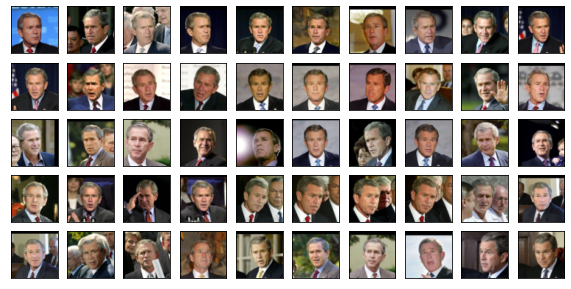

In [4]:
_ = plot.dataset_first_n(ds_gwb, 50, figsize=(10,5), nrows=5)
print(f'Found {len(ds_gwb)} images in dataset folder.')

In [5]:
import dcgan as gan

print("### Image size")
x0, y0 = ds_gwb[0]
x0 = x0.unsqueeze(0).to(device)
print(x0.shape)

print("#### Discriminator")
dsc = gan.Discriminator(in_size=x0[0].shape).to(device)
print(dsc)

print("### Discriminator output shape")
d0 = dsc(x0)
print(d0.shape)

print("### Generator")
z_dim = 128
gen = gan.Generator(z_dim, 4).to(device)
print(gen)

print("### Generator output shape")
z = torch.randn(1, z_dim,1,1).to(device)
xr = gen(z)
print(xr.shape)

### Image size
torch.Size([1, 3, 64, 64])
#### Discriminator
Discriminator(
  (feature_extractor): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReL

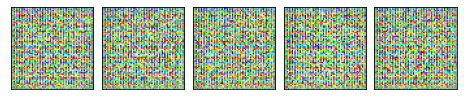

In [6]:
samples = gen.sample(5, with_grad=False)
_ = plot.tensors_as_images(samples.cpu())


In [10]:
import torch.optim as optim
from torch.utils.data import DataLoader

torch.manual_seed(999)

# Hyperparams
hp = dict(
        batch_size=32, z_dim=100, data_label=1, label_noise=0.2,
        discriminator_optimizer=dict(
            type='Adam', 
            lr=0.0002,
            weight_decay=0.02,
            betas=(0.5, 0.999)
        ),
        generator_optimizer=dict(
            type='Adam',  
            lr=0.0002,
            weight_decay=0.02,
            betas=(0.5, 0.999)
        ),
    )
    

# Data
dl_train = DataLoader(ds_gwb, hp['batch_size'], shuffle=True)
im_size = ds_gwb[0][0].shape

# Model
dsc = gan.Discriminator(im_size).to(device)
gen = gan.Generator(z_dim, featuremap_size=4).to(device)

# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
        
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
gen.apply(weights_init)
dsc.apply(weights_init)

# Optimizer
def create_optimizer(model_params, opt_params):
    opt_params = opt_params.copy()
    optimizer_type = opt_params['type']
    opt_params.pop('type')
    return optim.__dict__[optimizer_type](model_params, **opt_params)

dsc_optimizer = create_optimizer(dsc.parameters(), hp['discriminator_optimizer'])
gen_optimizer = create_optimizer(gen.parameters(), hp['generator_optimizer'])

# Loss
def dsc_loss_fn(y_data, y_generated):
    return gan.discriminator_loss_fn(y_data, y_generated, hp['data_label'], hp['label_noise'])

def gen_loss_fn(y_generated):
    return gan.generator_loss_fn(y_generated, hp['data_label'])

# Training
checkpoint_file = 'checkpoints/gan'
checkpoint_file_final = f'{checkpoint_file}_final'
if os.path.isfile(f'{checkpoint_file}.pt'):
    os.remove(f'{checkpoint_file}.pt')

# Show hypers
print(hp)

{'batch_size': 32, 'z_dim': 100, 'data_label': 1, 'label_noise': 0.2, 'discriminator_optimizer': {'type': 'Adam', 'lr': 0.0002, 'weight_decay': 0.02, 'betas': (0.5, 0.999)}, 'generator_optimizer': {'type': 'Adam', 'lr': 0.0002, 'weight_decay': 0.02, 'betas': (0.5, 0.999)}}


--- EPOCH 1/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.31it/s]
Discriminator loss: 0.5512783474781934
Generator loss:     9.662150607389563


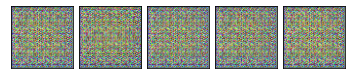

--- EPOCH 2/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.7294140068047187
Generator loss:     18.593411024879007


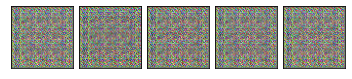

--- EPOCH 3/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.4946109663475962
Generator loss:     17.031580644495346


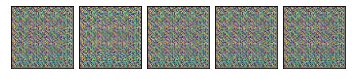

--- EPOCH 4/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.32it/s]
Discriminator loss: 0.41634288386386986
Generator loss:     20.022679328918457


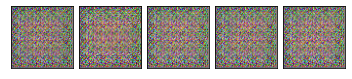

--- EPOCH 5/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.31616779789328575
Generator loss:     17.672719029819262
Saved checkpoint.


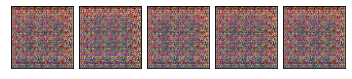

--- EPOCH 6/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.31it/s]
Discriminator loss: 0.2414720485753873
Generator loss:     25.754109578974106


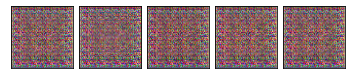

--- EPOCH 7/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.32it/s]
Discriminator loss: -0.0030495967058574453
Generator loss:     31.04082270229564


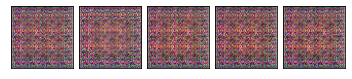

--- EPOCH 8/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.30it/s]
Discriminator loss: 0.2346990985028884
Generator loss:     32.40751014036291


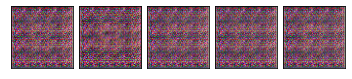

--- EPOCH 9/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: -0.08090928744743853
Generator loss:     42.725439857034125


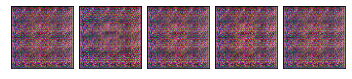

--- EPOCH 10/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.31it/s]
Discriminator loss: 0.05470547167693868
Generator loss:     42.47029024011948
Saved checkpoint.


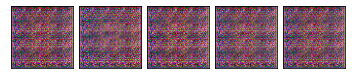

--- EPOCH 11/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.008706116501022787
Generator loss:     42.14495625215418


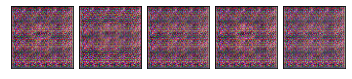

--- EPOCH 12/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.31it/s]
Discriminator loss: 0.0998873101437793
Generator loss:     41.70868593103745


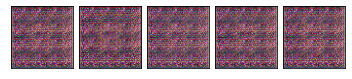

--- EPOCH 13/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.03679080263656728
Generator loss:     41.29822360768038


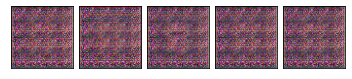

--- EPOCH 14/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.16649581754908843
Generator loss:     40.987594828886145


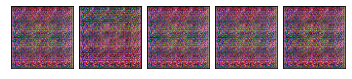

--- EPOCH 15/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.06126991264960345
Generator loss:     40.86181214276482
Saved checkpoint.


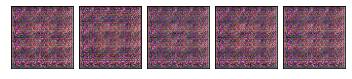

--- EPOCH 16/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: -0.16723826965864966
Generator loss:     40.78769369686351


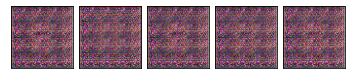

--- EPOCH 17/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.11035041291924085
Generator loss:     40.533534554874194


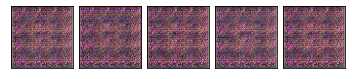

--- EPOCH 18/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.06952965434859781
Generator loss:     40.25186314302332


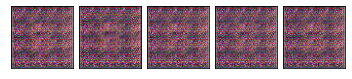

--- EPOCH 19/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: -0.11967614073963727
Generator loss:     39.94427714628332


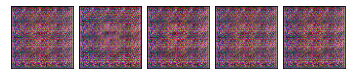

--- EPOCH 20/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: -0.016955305548275217
Generator loss:     39.59945499195772
Saved checkpoint.


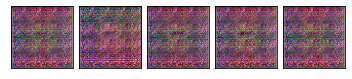

--- EPOCH 21/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.14434915561886394
Generator loss:     39.07973637300379


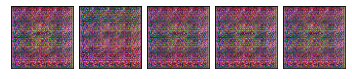

--- EPOCH 22/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: -0.14241919162518837
Generator loss:     36.8970214619356


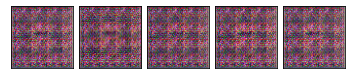

--- EPOCH 23/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 1.2169082361985655
Generator loss:     26.381185251123764


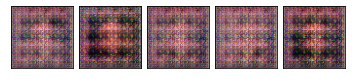

--- EPOCH 24/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.31it/s]
Discriminator loss: 1.9608263176153689
Generator loss:     10.758681297302246


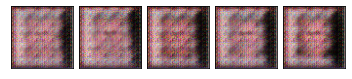

--- EPOCH 25/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 1.3758527058012344
Generator loss:     8.634664479423972
Saved checkpoint.


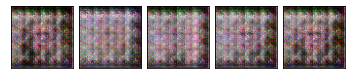

--- EPOCH 26/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.932458874057321
Generator loss:     4.4212822493384865


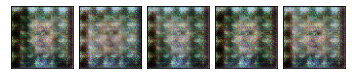

--- EPOCH 27/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 1.3117093093254988
Generator loss:     4.334683348150814


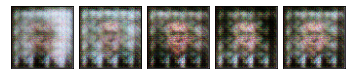

--- EPOCH 28/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 1.8112048892413868
Generator loss:     3.2045845845166374


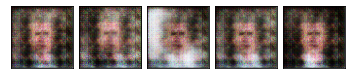

--- EPOCH 29/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 1.4055013025508207
Generator loss:     2.6580165344126083


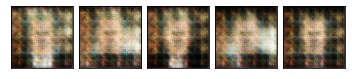

--- EPOCH 30/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 1.3101233594557817
Generator loss:     3.122201856444864
Saved checkpoint.


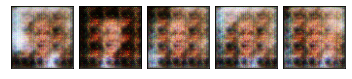

--- EPOCH 31/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 1.1178621825049906
Generator loss:     3.0359637877520393


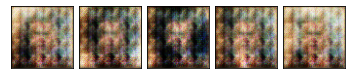

--- EPOCH 32/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.908642490120495
Generator loss:     3.1517262318555046


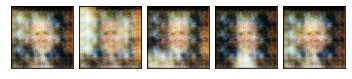

--- EPOCH 33/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 1.2106334356700672
Generator loss:     3.8035507482640885


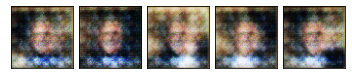

--- EPOCH 34/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 1.097574433859657
Generator loss:     3.482575360466452


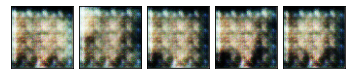

--- EPOCH 35/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.9470704934176277
Generator loss:     3.9505471622242645
Saved checkpoint.


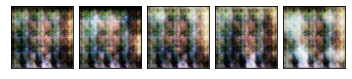

--- EPOCH 36/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 1.0960045527009403
Generator loss:     3.5534612010507023


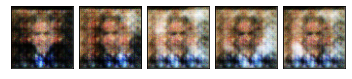

--- EPOCH 37/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.32it/s]
Discriminator loss: 1.0869911137749166
Generator loss:     3.203224743113798


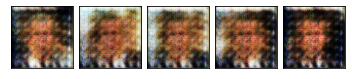

--- EPOCH 38/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 1.1436484701493208
Generator loss:     3.502058933762943


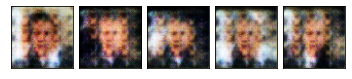

--- EPOCH 39/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 1.1080372964634615
Generator loss:     2.929084195810206


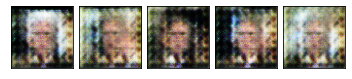

--- EPOCH 40/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.32it/s]
Discriminator loss: 1.2110919777084799
Generator loss:     2.8393586102653954
Saved checkpoint.


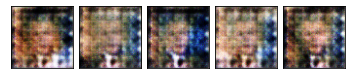

--- EPOCH 41/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 1.2651851738200468
Generator loss:     3.0078431017258587


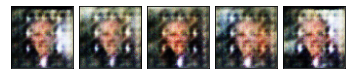

--- EPOCH 42/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 1.2419265719021069
Generator loss:     2.670211721869076


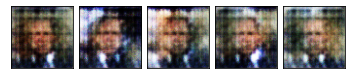

--- EPOCH 43/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 1.1845480273751652
Generator loss:     2.461285289596109


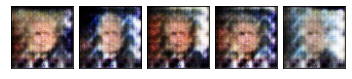

--- EPOCH 44/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 1.1626445230315714
Generator loss:     2.7879825549967148


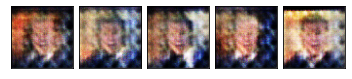

--- EPOCH 45/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 1.2005194741136886
Generator loss:     2.6684629847021664
Saved checkpoint.


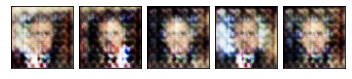

--- EPOCH 46/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 1.2608484064831453
Generator loss:     3.0171856389326206


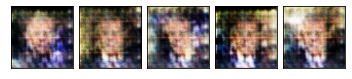

--- EPOCH 47/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 1.1952174130608053
Generator loss:     2.5948768854141235


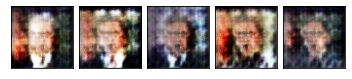

--- EPOCH 48/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 1.044354515917161
Generator loss:     2.557733683025136


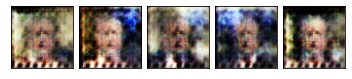

--- EPOCH 49/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 1.1884935077498942
Generator loss:     2.8698219972498276


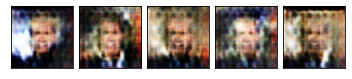

--- EPOCH 50/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 1.279919512131635
Generator loss:     3.0384455428403965
Saved checkpoint.


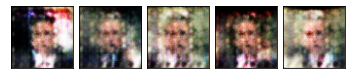

--- EPOCH 51/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 1.107981099801905
Generator loss:     2.6361220724442425


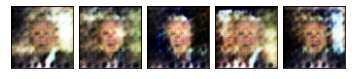

--- EPOCH 52/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 1.1734707320437712
Generator loss:     2.773107171058655


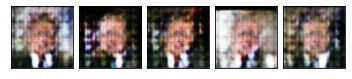

--- EPOCH 53/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 1.3059338401345646
Generator loss:     2.7781574305366066


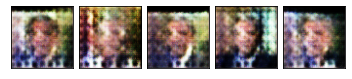

--- EPOCH 54/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 1.123313812648549
Generator loss:     2.703456668292775


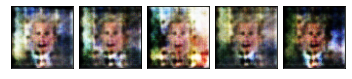

--- EPOCH 55/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 1.1550775556003345
Generator loss:     2.778623763252707
Saved checkpoint.


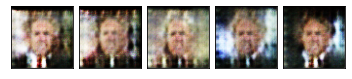

--- EPOCH 56/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 1.1796442094971151
Generator loss:     2.5291230888927685


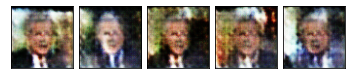

--- EPOCH 57/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 1.1687510644688326
Generator loss:     2.770789518075831


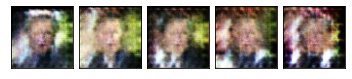

--- EPOCH 58/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.9901315675062292
Generator loss:     2.9024483175838696


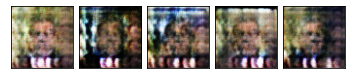

--- EPOCH 59/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 1.2118820583119112
Generator loss:     2.992380268433515


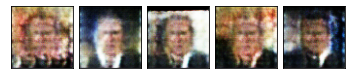

--- EPOCH 60/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 1.0390956542071175
Generator loss:     2.5976567058002247
Saved checkpoint.


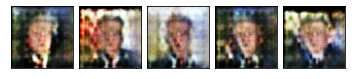

--- EPOCH 61/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.32it/s]
Discriminator loss: 1.183372553657083
Generator loss:     2.81590138463413


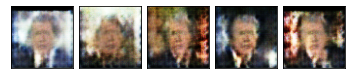

--- EPOCH 62/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 1.0475142002105713
Generator loss:     2.6784161118900074


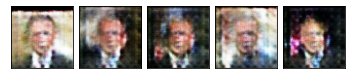

--- EPOCH 63/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 1.0911704231710995
Generator loss:     2.9057120575624356


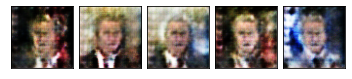

--- EPOCH 64/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 1.045098571216359
Generator loss:     2.821566203061272


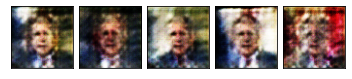

--- EPOCH 65/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 1.096838684643016
Generator loss:     2.7657285227495083
Saved checkpoint.


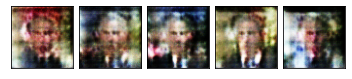

--- EPOCH 66/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 1.063036676715402
Generator loss:     2.696740045266993


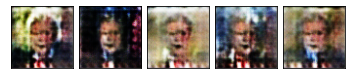

--- EPOCH 67/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 1.1448856837609236
Generator loss:     2.7555757761001587


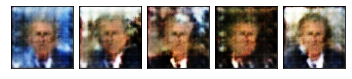

--- EPOCH 68/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 1.0888422482153948
Generator loss:     2.7774997388615326


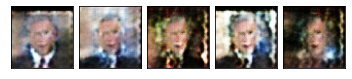

--- EPOCH 69/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 1.1528426128275253
Generator loss:     2.8381323674145866


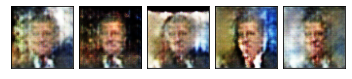

--- EPOCH 70/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 1.1155400802107418
Generator loss:     2.7575751262552597
Saved checkpoint.


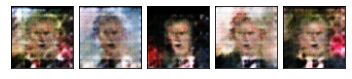

--- EPOCH 71/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 1.041192871682784
Generator loss:     2.3872664395500633


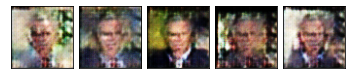

--- EPOCH 72/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 1.0595114686909843
Generator loss:     2.8099741234498867


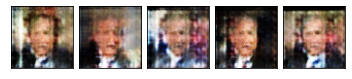

--- EPOCH 73/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.9747682704645044
Generator loss:     3.0632901472203873


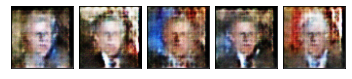

--- EPOCH 74/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 1.0593637788996977
Generator loss:     2.7833299075855926


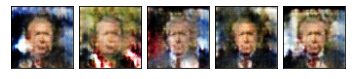

--- EPOCH 75/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 1.1071935786920435
Generator loss:     2.7658627804587868
Saved checkpoint.


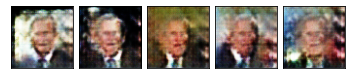

--- EPOCH 76/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.9425499404177946
Generator loss:     2.706206265617819


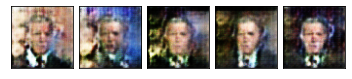

--- EPOCH 77/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 1.0420767735032475
Generator loss:     3.239633798599243


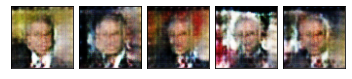

--- EPOCH 78/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.974822107483359
Generator loss:     3.0958872753031113


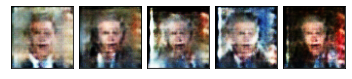

--- EPOCH 79/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 1.0091324729077957
Generator loss:     2.928456082063563


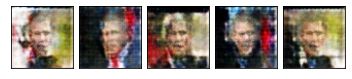

--- EPOCH 80/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.95489742826013
Generator loss:     3.0751640235676483
Saved checkpoint.


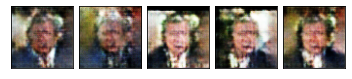

--- EPOCH 81/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 1.007708325105555
Generator loss:     3.0502562663134407


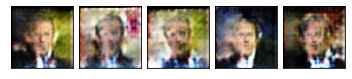

--- EPOCH 82/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 1.0077287659925573
Generator loss:     3.086207389831543


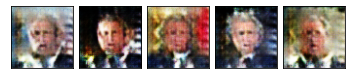

--- EPOCH 83/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.9827376639141756
Generator loss:     2.9485186338424683


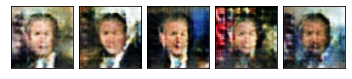

--- EPOCH 84/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.9579823262551251
Generator loss:     3.1495266661924473


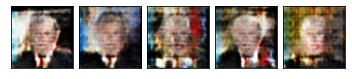

--- EPOCH 85/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.8615874157232397
Generator loss:     3.216952688553754
Saved checkpoint.


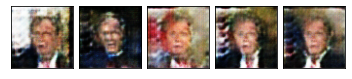

--- EPOCH 86/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 1.0146119489389307
Generator loss:     2.969306707382202


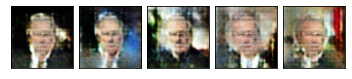

--- EPOCH 87/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.8894047947490916
Generator loss:     3.369594293482163


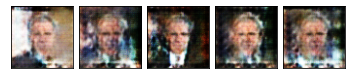

--- EPOCH 88/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 1.1163779777639053
Generator loss:     3.087811133440803


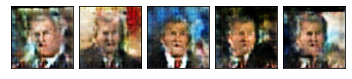

--- EPOCH 89/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.8715027044801151
Generator loss:     2.971146401237039


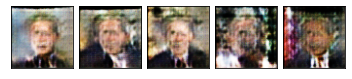

--- EPOCH 90/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.9414609705700594
Generator loss:     3.291942428140079
Saved checkpoint.


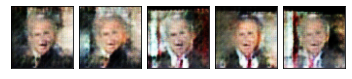

--- EPOCH 91/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.9496510554762447
Generator loss:     3.131442841361551


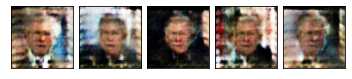

--- EPOCH 92/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.8289056946249569
Generator loss:     3.165322051328771


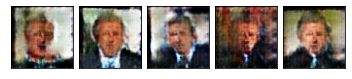

--- EPOCH 93/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.9270825456170475
Generator loss:     3.1721979449777042


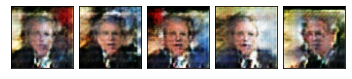

--- EPOCH 94/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.8295789361000061
Generator loss:     3.4500623450559726


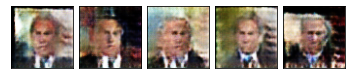

--- EPOCH 95/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.8146518223425921
Generator loss:     3.282565285177792
Saved checkpoint.


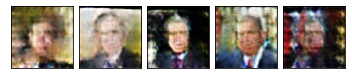

--- EPOCH 96/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.32it/s]
Discriminator loss: 0.8100985884666443
Generator loss:     3.380203801042893


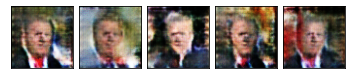

--- EPOCH 97/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.9167197241502649
Generator loss:     3.3480954310473274


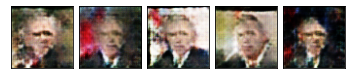

--- EPOCH 98/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.32it/s]
Discriminator loss: 0.8081029951572418
Generator loss:     3.5602349393508015


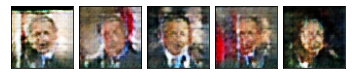

--- EPOCH 99/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.7837619220509249
Generator loss:     3.4791028569726383


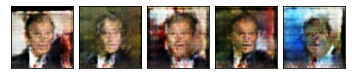

--- EPOCH 100/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.8129643938120674
Generator loss:     3.6578164240893196
Saved checkpoint.


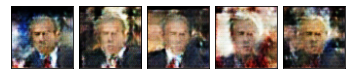

--- EPOCH 101/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.7878735223237205
Generator loss:     3.4865860378040985


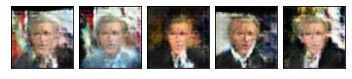

--- EPOCH 102/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.8912867693340077
Generator loss:     3.5179335650275734


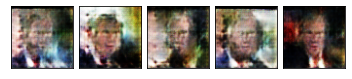

--- EPOCH 103/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.7373258366304285
Generator loss:     3.5884408670313217


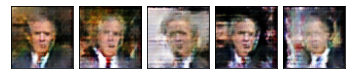

--- EPOCH 104/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.7677606168915244
Generator loss:     3.5230066495783188


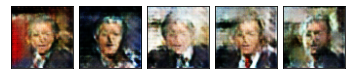

--- EPOCH 105/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.8628689436351552
Generator loss:     3.651433124261744
Saved checkpoint.


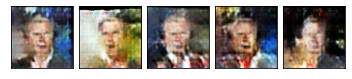

--- EPOCH 106/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.7531717892955331
Generator loss:     3.389806733411901


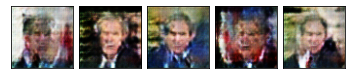

--- EPOCH 107/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.7624532475191004
Generator loss:     3.7809204073513256


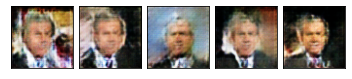

--- EPOCH 108/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.7912075379315544
Generator loss:     3.391388738856596


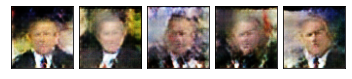

--- EPOCH 109/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.7510733113569372
Generator loss:     3.832026116988238


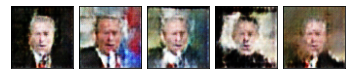

--- EPOCH 110/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.8491348606698653
Generator loss:     3.6615926448036644
Saved checkpoint.


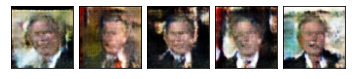

--- EPOCH 111/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.7985603844418245
Generator loss:     3.506213524762322


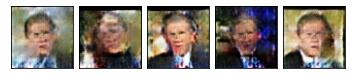

--- EPOCH 112/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.7206365325871635
Generator loss:     3.3528975739198574


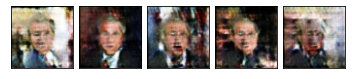

--- EPOCH 113/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.6823041333871729
Generator loss:     3.8412180648130527


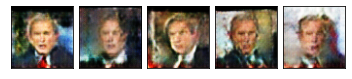

--- EPOCH 114/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.32it/s]
Discriminator loss: 0.8073354538749246
Generator loss:     3.784102341708015


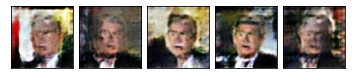

--- EPOCH 115/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.5920000865178949
Generator loss:     3.688522044350119
Saved checkpoint.


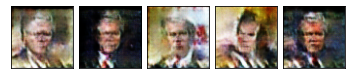

--- EPOCH 116/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.6796784348347608
Generator loss:     3.9283260738148407


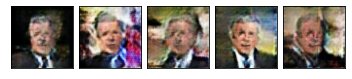

--- EPOCH 117/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.6968239423106698
Generator loss:     3.821191240759457


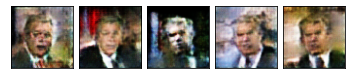

--- EPOCH 118/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.8109530245556551
Generator loss:     3.962739986531875


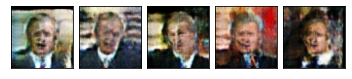

--- EPOCH 119/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.5968675928957322
Generator loss:     3.887164256151985


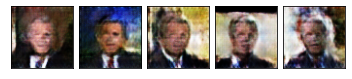

--- EPOCH 120/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.32it/s]
Discriminator loss: 0.6781607726041008
Generator loss:     3.9875044261707977
Saved checkpoint.


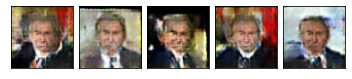

--- EPOCH 121/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.559582266737433
Generator loss:     3.7711086413439583


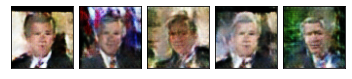

--- EPOCH 122/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.6299553794019362
Generator loss:     4.1221550071940705


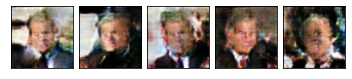

--- EPOCH 123/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.8686665208900676
Generator loss:     4.117829259704141


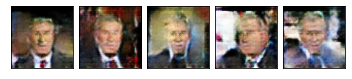

--- EPOCH 124/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.7164726678062888
Generator loss:     4.172457218170166


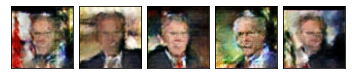

--- EPOCH 125/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.5449150905889624
Generator loss:     3.7600059509277344
Saved checkpoint.


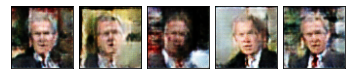

--- EPOCH 126/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.5144965455812567
Generator loss:     3.989324681899127


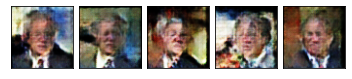

--- EPOCH 127/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.7509607041583342
Generator loss:     4.079641594606287


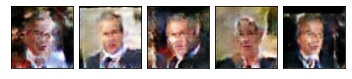

--- EPOCH 128/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.7727008234052097
Generator loss:     3.9073828528909123


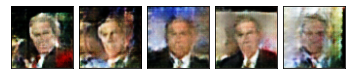

--- EPOCH 129/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.5582755330730887
Generator loss:     4.043091647765216


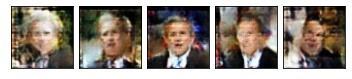

--- EPOCH 130/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.42748988726559806
Generator loss:     3.6139860854429355
Saved checkpoint.


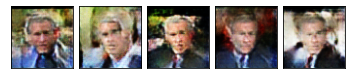

--- EPOCH 131/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.5178120031076319
Generator loss:     4.104318310232723


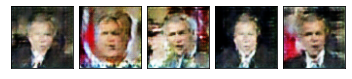

--- EPOCH 132/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.47511665698359995
Generator loss:     4.257609437493717


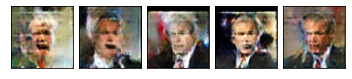

--- EPOCH 133/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.5078424671116997
Generator loss:     4.284238759209128


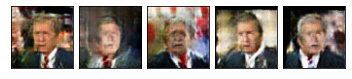

--- EPOCH 134/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.6041145570137921
Generator loss:     4.302798495573156


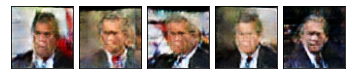

--- EPOCH 135/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.5538492886459127
Generator loss:     4.425721855724559
Saved checkpoint.


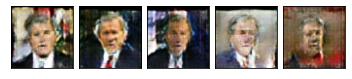

--- EPOCH 136/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.6297983860268312
Generator loss:     4.406292662901037


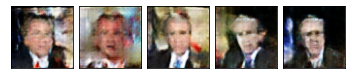

--- EPOCH 137/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.5236582791104036
Generator loss:     4.121662981369916


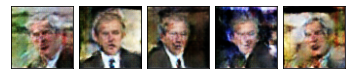

--- EPOCH 138/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.6748708223595339
Generator loss:     4.493875321219949


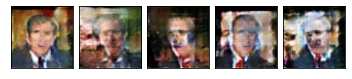

--- EPOCH 139/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.7098838073365829
Generator loss:     4.497276853112614


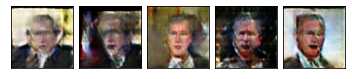

--- EPOCH 140/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.4328879994504592
Generator loss:     4.090143245809219
Saved checkpoint.


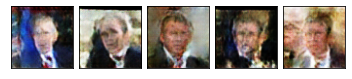

--- EPOCH 141/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.3678980820319232
Generator loss:     4.25285548322341


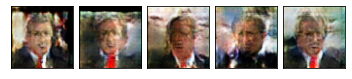

--- EPOCH 142/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.38743020550293084
Generator loss:     4.210011874928194


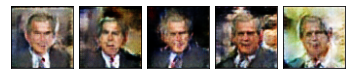

--- EPOCH 143/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.36132896121810465
Generator loss:     4.559090277727912


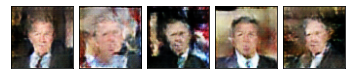

--- EPOCH 144/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.2769804903689553
Generator loss:     4.473147574593039


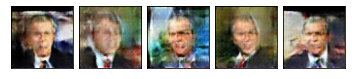

--- EPOCH 145/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.7853957515429048
Generator loss:     5.209551355418037
Saved checkpoint.


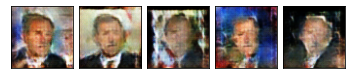

--- EPOCH 146/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.6926452710348017
Generator loss:     4.358944612390855


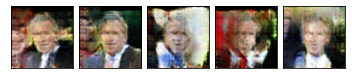

--- EPOCH 147/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.5400043445474961
Generator loss:     4.451169617035809


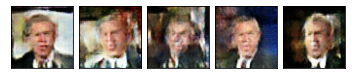

--- EPOCH 148/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.361556309987517
Generator loss:     4.3014136202195115


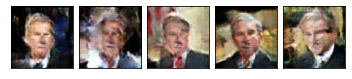

--- EPOCH 149/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.3368080793058171
Generator loss:     4.386369298486149


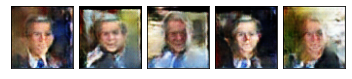

--- EPOCH 150/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.2733059919932309
Generator loss:     4.368445985457477
Saved checkpoint.


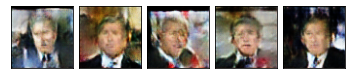

--- EPOCH 151/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.3622496312155443
Generator loss:     5.025799036026001


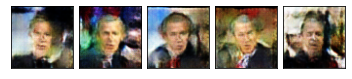

--- EPOCH 152/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.5577646809465745
Generator loss:     5.2606723028070785


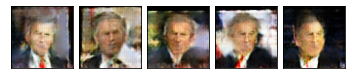

--- EPOCH 153/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.9983613508589128
Generator loss:     4.496236212113324


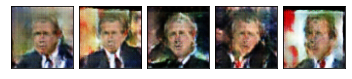

--- EPOCH 154/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.32it/s]
Discriminator loss: 0.5279473837684182
Generator loss:     4.231128524331486


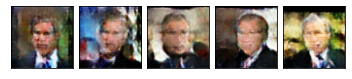

--- EPOCH 155/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.3804669923642102
Generator loss:     4.153906317318187
Saved checkpoint.


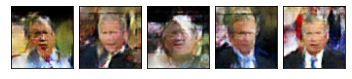

--- EPOCH 156/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.39062663386849794
Generator loss:     4.4488202403573425


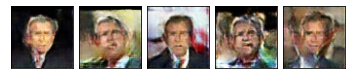

--- EPOCH 157/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.30it/s]
Discriminator loss: 0.33859585137928233
Generator loss:     4.567033375010771


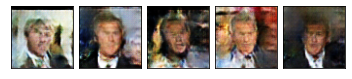

--- EPOCH 158/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.32it/s]
Discriminator loss: 0.3635331795496099
Generator loss:     4.908078712575576


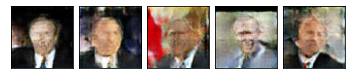

--- EPOCH 159/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.3564552068710327
Generator loss:     4.741353161194745


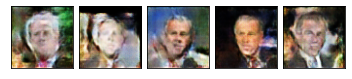

--- EPOCH 160/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.3551928663955015
Generator loss:     4.809913999894086
Saved checkpoint.


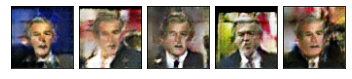

--- EPOCH 161/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.35383373849532185
Generator loss:     5.090302817961749


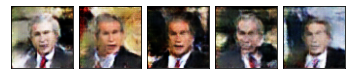

--- EPOCH 162/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.34653950745568557
Generator loss:     4.831684701582965


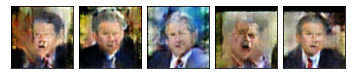

--- EPOCH 163/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.7138497242156197
Generator loss:     5.578275947009816


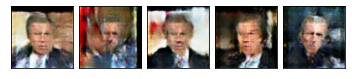

--- EPOCH 164/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.7311302107923171
Generator loss:     4.931329053990981


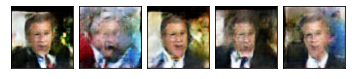

--- EPOCH 165/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.30it/s]
Discriminator loss: 0.45163365847924175
Generator loss:     4.4749433293062095
Saved checkpoint.


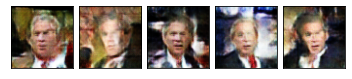

--- EPOCH 166/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.39474182269152475
Generator loss:     4.523124975316665


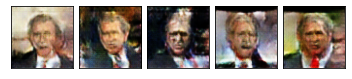

--- EPOCH 167/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.35010500865824085
Generator loss:     4.682711615281947


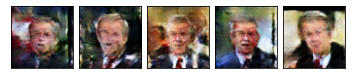

--- EPOCH 168/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.2435099158216925
Generator loss:     4.67039083032047


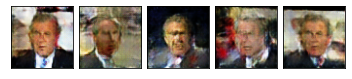

--- EPOCH 169/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.1855775889228372
Generator loss:     4.70975240539102


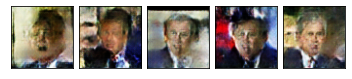

--- EPOCH 170/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.13633290831657016
Generator loss:     4.632699615815106
Saved checkpoint.


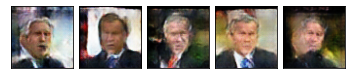

--- EPOCH 171/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.20785263531348286
Generator loss:     5.112150290433099


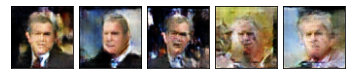

--- EPOCH 172/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.27975814570398894
Generator loss:     5.351655174704159


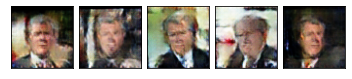

--- EPOCH 173/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.3078923663672279
Generator loss:     5.24025876381818


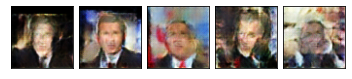

--- EPOCH 174/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.4090387084904839
Generator loss:     5.583983463399551


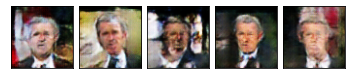

--- EPOCH 175/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.7021958144272075
Generator loss:     6.027262112673591
Saved checkpoint.


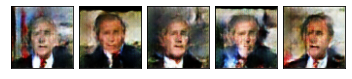

--- EPOCH 176/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.6622992420897764
Generator loss:     5.5306391996495865


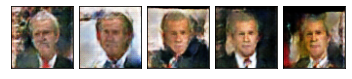

--- EPOCH 177/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.5284314330886392
Generator loss:     4.943515623317046


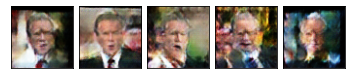

--- EPOCH 178/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.289024977999575
Generator loss:     4.560689799925861


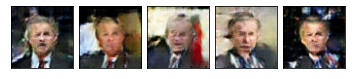

--- EPOCH 179/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.28025462829014836
Generator loss:     4.696584687513464


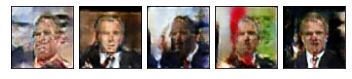

--- EPOCH 180/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.4414171764955801
Generator loss:     5.066910266876221
Saved checkpoint.


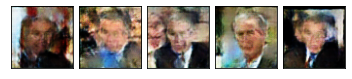

--- EPOCH 181/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.32it/s]
Discriminator loss: 0.2538136800422388
Generator loss:     4.783119019340067


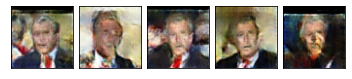

--- EPOCH 182/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.19741908110239925
Generator loss:     4.828449655981625


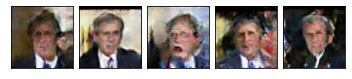

--- EPOCH 183/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.1800096381236525
Generator loss:     4.8288951481089875


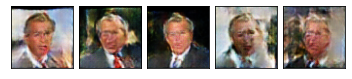

--- EPOCH 184/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.36308713344966664
Generator loss:     5.689903694040635


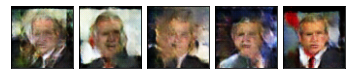

--- EPOCH 185/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.37969957818003264
Generator loss:     5.853915747474222
Saved checkpoint.


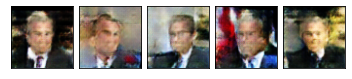

--- EPOCH 186/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.34978853078449473
Generator loss:     5.222504251143512


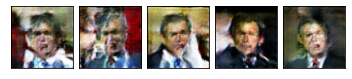

--- EPOCH 187/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.2844722718000412
Generator loss:     5.4232313913457535


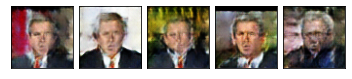

--- EPOCH 188/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.22404229202691248
Generator loss:     5.582425215665032


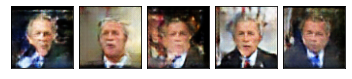

--- EPOCH 189/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.2305784720708342
Generator loss:     5.474151190589456


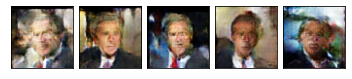

--- EPOCH 190/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.8502326274619383
Generator loss:     5.9701376101549934
Saved checkpoint.


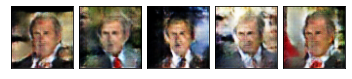

--- EPOCH 191/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.3846658503308016
Generator loss:     5.083651430466595


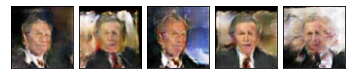

--- EPOCH 192/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.5724198401850813
Generator loss:     5.179280547534718


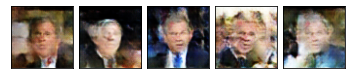

--- EPOCH 193/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.28155577796347003
Generator loss:     4.597831852295819


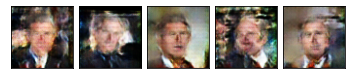

--- EPOCH 194/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.17728741313604748
Generator loss:     4.578134424546185


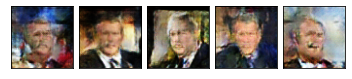

--- EPOCH 195/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.14682932482922778
Generator loss:     4.845069913303151
Saved checkpoint.


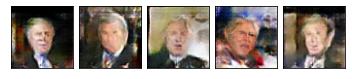

--- EPOCH 196/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.14566514575306108
Generator loss:     4.9831427125369805


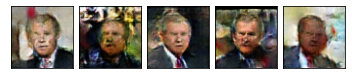

--- EPOCH 197/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.18356228838948643
Generator loss:     4.900122993132648


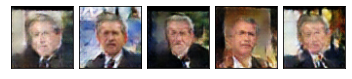

--- EPOCH 198/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.1636608115890447
Generator loss:     5.397552924997666


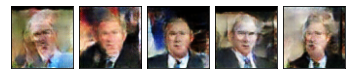

--- EPOCH 199/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 1.015601135790348
Generator loss:     5.880184264744029


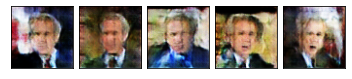

--- EPOCH 200/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.644646588493796
Generator loss:     5.1346516609191895
Saved checkpoint.


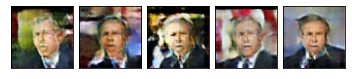

--- EPOCH 201/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.4307936394915861
Generator loss:     4.719711065292358


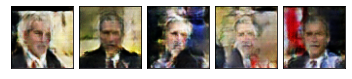

--- EPOCH 202/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.28545133725685234
Generator loss:     4.598267344867482


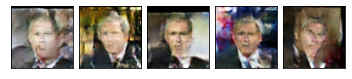

--- EPOCH 203/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.2513042127384859
Generator loss:     5.091637260773602


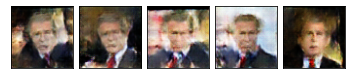

--- EPOCH 204/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.28930962348685546
Generator loss:     4.924421043956981


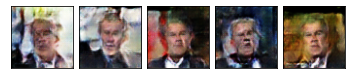

--- EPOCH 205/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.19516676795833252
Generator loss:     5.048832584829891
Saved checkpoint.


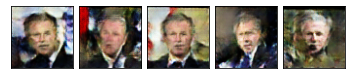

--- EPOCH 206/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.1490497025935089
Generator loss:     4.907193772933063


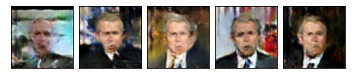

--- EPOCH 207/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.13060867260484135
Generator loss:     4.821280872120576


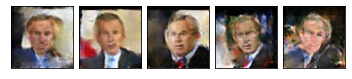

--- EPOCH 208/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.16886165529927788
Generator loss:     5.184128957636216


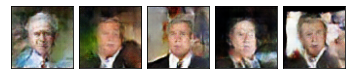

--- EPOCH 209/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.22285218493026845
Generator loss:     5.813944648293888


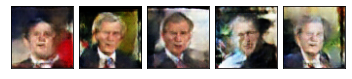

--- EPOCH 210/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.2018696104778963
Generator loss:     5.626086291144876
Saved checkpoint.


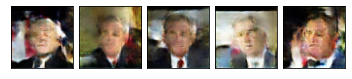

--- EPOCH 211/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.19067709147930145
Generator loss:     5.737293790368473


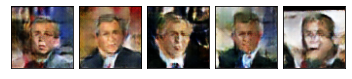

--- EPOCH 212/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.1978588638936772
Generator loss:     5.855573794421027


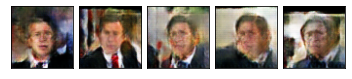

--- EPOCH 213/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.1269707061788615
Generator loss:     5.535469868603875


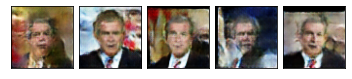

--- EPOCH 214/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.21217915415763855
Generator loss:     5.6115637667038865


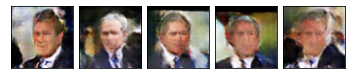

--- EPOCH 215/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.7563774033504373
Generator loss:     6.759946724947761
Saved checkpoint.


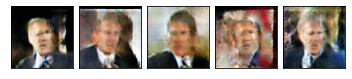

--- EPOCH 216/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.9548211991786957
Generator loss:     5.293010781793034


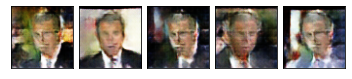

--- EPOCH 217/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.4506629968390745
Generator loss:     5.059731918222764


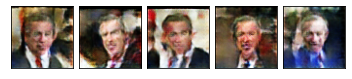

--- EPOCH 218/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.3203325604691225
Generator loss:     4.725731611251831


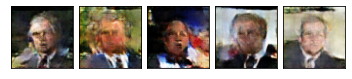

--- EPOCH 219/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.20994786961990244
Generator loss:     4.823044818990371


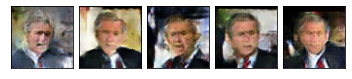

--- EPOCH 220/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.1691107114448267
Generator loss:     4.753792566411636
Saved checkpoint.


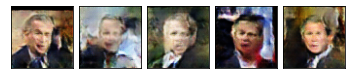

--- EPOCH 221/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.24346358745413668
Generator loss:     5.281322549371159


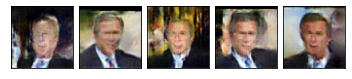

--- EPOCH 222/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.2671692866612883
Generator loss:     5.413798290140488


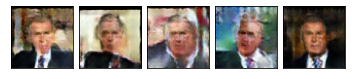

--- EPOCH 223/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 1.0428564934169544
Generator loss:     5.426785048316507


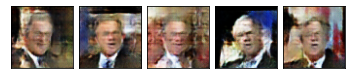

--- EPOCH 224/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.46847516473601847
Generator loss:     4.817400245105519


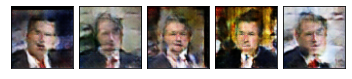

--- EPOCH 225/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.29306187612168927
Generator loss:     4.828988257576437
Saved checkpoint.


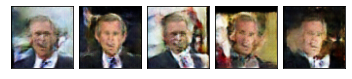

--- EPOCH 226/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.19712462758316712
Generator loss:     4.73117592755486


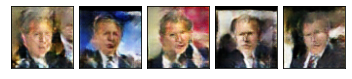

--- EPOCH 227/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.16373038226190736
Generator loss:     4.877476608051973


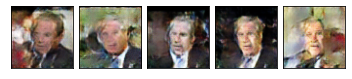

--- EPOCH 228/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.17022534328348496
Generator loss:     5.180778419270235


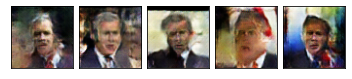

--- EPOCH 229/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.16420593419495752
Generator loss:     5.033432848313275


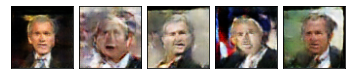

--- EPOCH 230/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.11873817115145571
Generator loss:     5.06714397318223
Saved checkpoint.


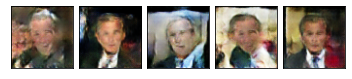

--- EPOCH 231/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.16180158012053547
Generator loss:     5.570491987116196


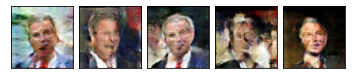

--- EPOCH 232/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.13743340673253818
Generator loss:     5.320016889011159


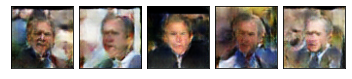

--- EPOCH 233/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.11317608417833552
Generator loss:     5.347843450658462


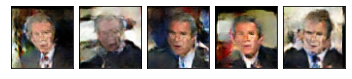

--- EPOCH 234/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.11915886960923672
Generator loss:     5.429195852840648


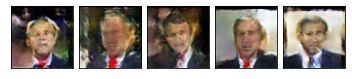

--- EPOCH 235/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 1.0330939047476824
Generator loss:     6.505928881028119
Saved checkpoint.


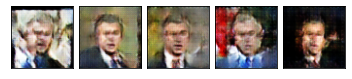

--- EPOCH 236/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.6496552263989168
Generator loss:     5.223906909718233


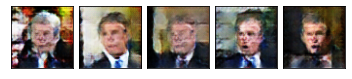

--- EPOCH 237/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.3659827831913443
Generator loss:     4.966573490816004


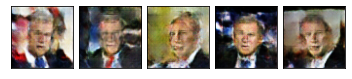

--- EPOCH 238/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.2561873824280851
Generator loss:     4.9139197012957405


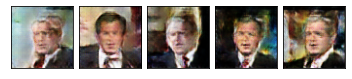

--- EPOCH 239/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.17529261462828694
Generator loss:     4.790059720768648


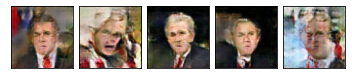

--- EPOCH 240/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.1757102219716591
Generator loss:     4.925660357755773
Saved checkpoint.


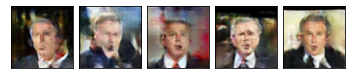

--- EPOCH 241/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.17469640207641265
Generator loss:     5.262124804889455


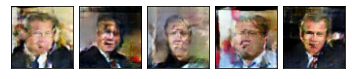

--- EPOCH 242/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.6183446049690247
Generator loss:     6.105483980739818


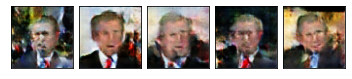

--- EPOCH 243/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.3451447846258388
Generator loss:     5.217459314009723


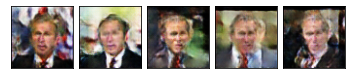

--- EPOCH 244/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.2765718233935973
Generator loss:     5.170004508074592


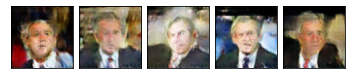

--- EPOCH 245/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.19066128879785538
Generator loss:     5.151072642382453
Saved checkpoint.


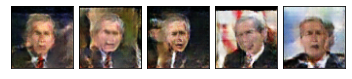

--- EPOCH 246/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.18271523100488327
Generator loss:     4.956965137930477


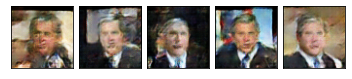

--- EPOCH 247/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.18753176987828576
Generator loss:     5.4091995603897995


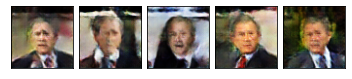

--- EPOCH 248/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.14683427749311223
Generator loss:     5.582047322217156


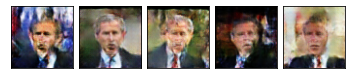

--- EPOCH 249/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.13443384987904744
Generator loss:     5.1278082623201255


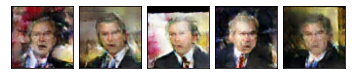

--- EPOCH 250/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.07519136938978643
Generator loss:     5.498615068547866
Saved checkpoint.


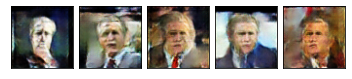

--- EPOCH 251/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.1429502175134771
Generator loss:     5.669641803292667


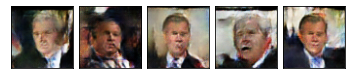

--- EPOCH 252/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.7722315542838153
Generator loss:     6.519987779505112


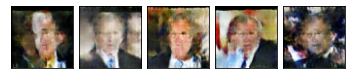

--- EPOCH 253/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.5380882270195905
Generator loss:     5.37626509105458


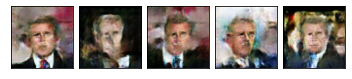

--- EPOCH 254/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.3421185454901527
Generator loss:     5.270288860096651


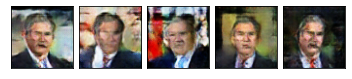

--- EPOCH 255/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.2049722772310762
Generator loss:     4.92139757380766
Saved checkpoint.


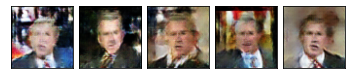

--- EPOCH 256/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.14992251564912937
Generator loss:     5.180774772868437


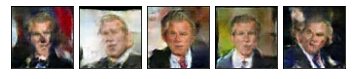

--- EPOCH 257/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.1337813073221375
Generator loss:     4.87575906865737


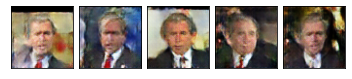

--- EPOCH 258/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.10219703581841554
Generator loss:     5.149804760428036


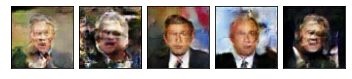

--- EPOCH 259/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.13056571058490696
Generator loss:     5.437029558069566


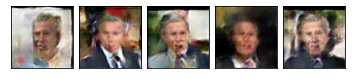

--- EPOCH 260/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.13721190228619995
Generator loss:     5.2932797319748826
Saved checkpoint.


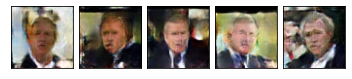

--- EPOCH 261/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.23498706563430674
Generator loss:     5.8564707671894745


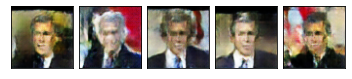

--- EPOCH 262/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.2745673235724954
Generator loss:     6.084171884200153


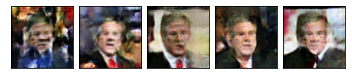

--- EPOCH 263/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.19970006342319882
Generator loss:     5.759226069730871


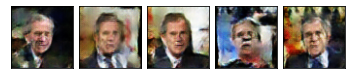

--- EPOCH 264/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.16558929927208843
Generator loss:     5.783185790566837


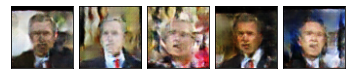

--- EPOCH 265/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.2211106388884432
Generator loss:     5.901500561658074
Saved checkpoint.


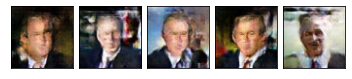

--- EPOCH 266/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.25396692971972856
Generator loss:     6.15604653077967


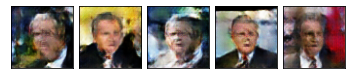

--- EPOCH 267/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.16176869807874455
Generator loss:     5.987055904725018


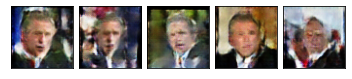

--- EPOCH 268/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.18524887763402043
Generator loss:     5.7698875595541566


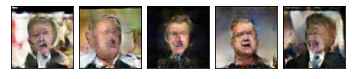

--- EPOCH 269/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.41it/s]
Discriminator loss: 0.17471485278185675
Generator loss:     5.918828234953039


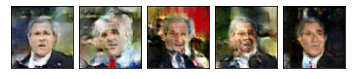

--- EPOCH 270/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.20035349840626998
Generator loss:     6.395795962389777
Saved checkpoint.


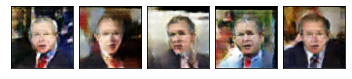

--- EPOCH 271/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.24090035084415884
Generator loss:     6.452913985532873


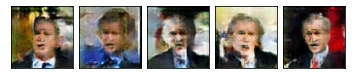

--- EPOCH 272/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.254685462835957
Generator loss:     6.062218048993279


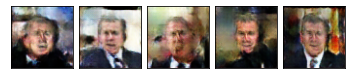

--- EPOCH 273/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.5720847669769736
Generator loss:     6.069167642032399


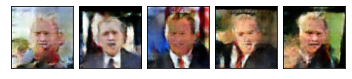

--- EPOCH 274/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.25383710861206055
Generator loss:     5.438270316404455


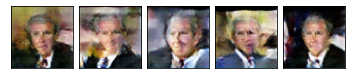

--- EPOCH 275/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.27476447119432335
Generator loss:     5.622070733238669
Saved checkpoint.


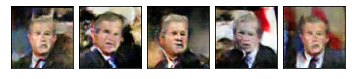

--- EPOCH 276/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.14176168621462934
Generator loss:     5.457941055297852


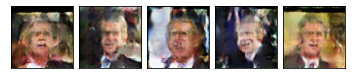

--- EPOCH 277/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.14318330125773654
Generator loss:     5.555514475878547


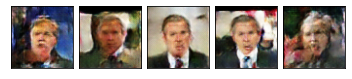

--- EPOCH 278/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.0944141799255329
Generator loss:     5.353740467744715


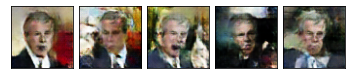

--- EPOCH 279/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.9581988839542165
Generator loss:     6.30631672634798


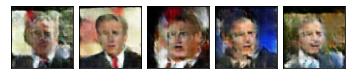

--- EPOCH 280/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.9936702076126548
Generator loss:     4.989463974447811
Saved checkpoint.


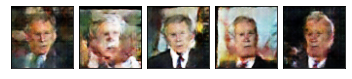

--- EPOCH 281/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.5016900809372172
Generator loss:     4.727679462993846


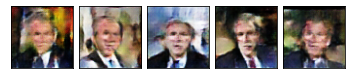

--- EPOCH 282/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.33235671590356264
Generator loss:     4.523697544546688


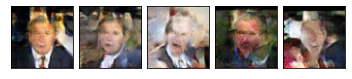

--- EPOCH 283/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.2103817252551808
Generator loss:     4.731674671173096


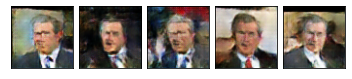

--- EPOCH 284/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.18055817397201762
Generator loss:     4.745806553784539


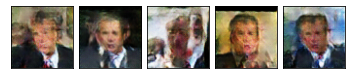

--- EPOCH 285/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.13746487086310105
Generator loss:     5.063205186058493
Saved checkpoint.


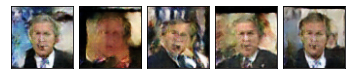

--- EPOCH 286/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.11984256052357309
Generator loss:     5.036870984470143


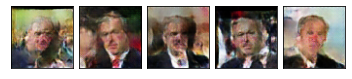

--- EPOCH 287/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.14620889920522184
Generator loss:     5.240062825820026


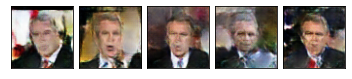

--- EPOCH 288/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.11104125222739052
Generator loss:     4.9976557142594284


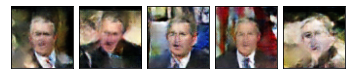

--- EPOCH 289/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.1490836989353685
Generator loss:     5.712158315321979


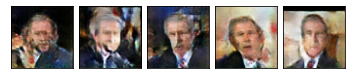

--- EPOCH 290/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.32it/s]
Discriminator loss: 0.36672839171746197
Generator loss:     5.914365095250747
Saved checkpoint.


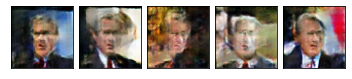

--- EPOCH 291/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.3526186820338754
Generator loss:     5.7240658227135155


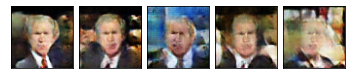

--- EPOCH 292/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.43328531612368193
Generator loss:     5.837008700651281


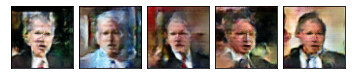

--- EPOCH 293/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.3432989153353607
Generator loss:     5.235361716326545


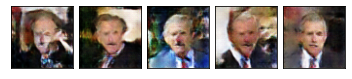

--- EPOCH 294/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.16167234454084844
Generator loss:     5.019875189837287


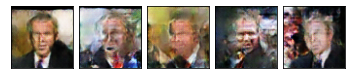

--- EPOCH 295/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.42it/s]
Discriminator loss: 0.12255651350407039
Generator loss:     5.061411619186401
Saved checkpoint.


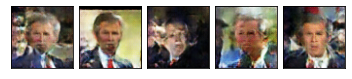

--- EPOCH 296/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.1419415237272487
Generator loss:     5.723400943419513


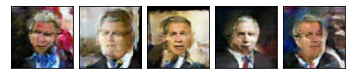

--- EPOCH 297/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.11152506805956364
Generator loss:     5.205231189727783


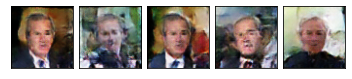

--- EPOCH 298/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.13017583090592832
Generator loss:     5.738263522877412


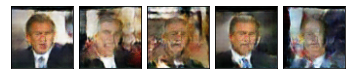

--- EPOCH 299/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.10032446704366628
Generator loss:     5.395546604605282


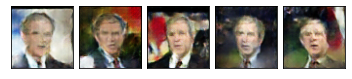

--- EPOCH 300/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.1524556737174006
Generator loss:     5.700789086958942
Saved checkpoint.


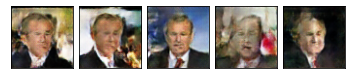

--- EPOCH 301/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.08222335379789858
Generator loss:     5.597478221444523


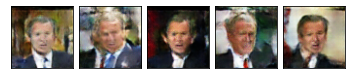

--- EPOCH 302/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.1305937093189534
Generator loss:     5.912307486814611


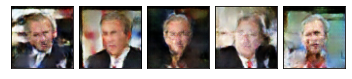

--- EPOCH 303/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.21897205776151488
Generator loss:     6.300186409669764


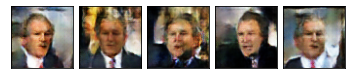

--- EPOCH 304/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 1.2181630905936747
Generator loss:     5.296545870163861


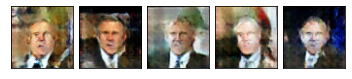

--- EPOCH 305/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.5636297604616951
Generator loss:     4.997088979272282
Saved checkpoint.


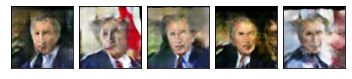

--- EPOCH 306/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.3450355740154491
Generator loss:     5.09970864127664


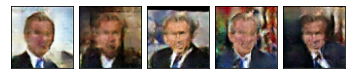

--- EPOCH 307/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.3176038063624326
Generator loss:     4.981056942659266


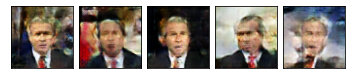

--- EPOCH 308/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.27395689925726724
Generator loss:     5.06741000624264


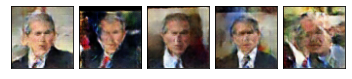

--- EPOCH 309/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.19818038186606238
Generator loss:     4.98657098938437


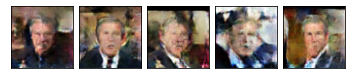

--- EPOCH 310/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.1082920438664801
Generator loss:     5.176120645859662
Saved checkpoint.


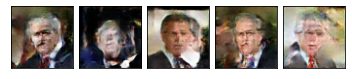

--- EPOCH 311/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.13009751018355875
Generator loss:     5.103392993702608


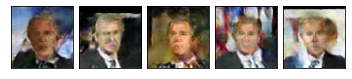

--- EPOCH 312/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.1017394331009949
Generator loss:     5.092403510037591


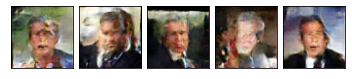

--- EPOCH 313/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.12925532942309098
Generator loss:     5.356477737426758


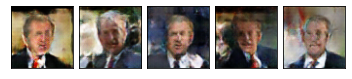

--- EPOCH 314/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.20549115582424052
Generator loss:     5.766941294950597


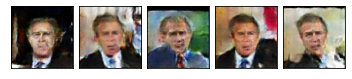

--- EPOCH 315/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.13741193892543807
Generator loss:     5.348737772773294
Saved checkpoint.


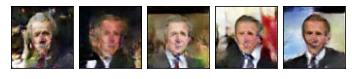

--- EPOCH 316/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.10382232048055705
Generator loss:     5.401854767518885


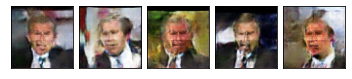

--- EPOCH 317/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.0767831290140748
Generator loss:     5.494569974787095


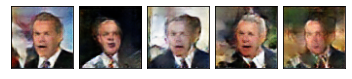

--- EPOCH 318/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.08208892461569871
Generator loss:     5.673390949473662


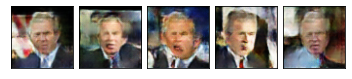

--- EPOCH 319/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.1098500680835808
Generator loss:     5.829948481391458


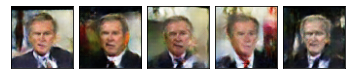

--- EPOCH 320/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.1135576650062028
Generator loss:     5.955859128166647
Saved checkpoint.


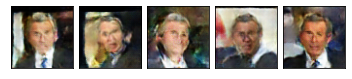

--- EPOCH 321/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.5107352588983143
Generator loss:     6.347247460309197


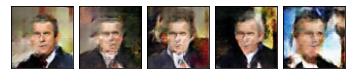

--- EPOCH 322/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.5428267682299894
Generator loss:     5.5334627207587745


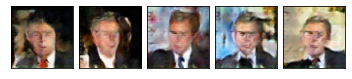

--- EPOCH 323/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.5171842198161518
Generator loss:     5.390254553626566


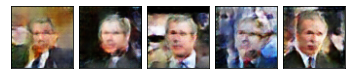

--- EPOCH 324/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.3291700894341749
Generator loss:     5.068722079781925


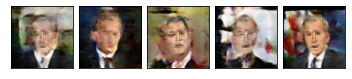

--- EPOCH 325/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.23074711508610668
Generator loss:     4.856299624723547
Saved checkpoint.


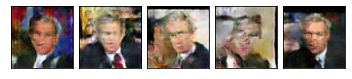

--- EPOCH 326/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.178546081571018
Generator loss:     5.190881546805887


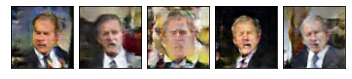

--- EPOCH 327/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.13930044377989628
Generator loss:     5.159764682545381


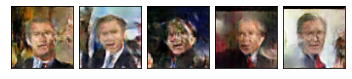

--- EPOCH 328/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.09887968946029158
Generator loss:     5.21253984114703


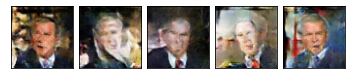

--- EPOCH 329/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.10790402003947426
Generator loss:     5.12682526251849


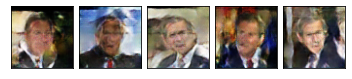

--- EPOCH 330/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.09476790708654068
Generator loss:     5.304846679463106
Saved checkpoint.


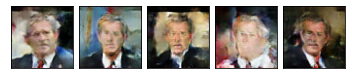

--- EPOCH 331/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.08136757824789076
Generator loss:     5.665439072777243


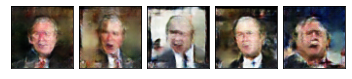

--- EPOCH 332/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.1256742202950751
Generator loss:     5.985633120817297


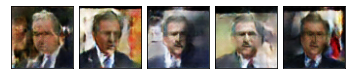

--- EPOCH 333/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.12123625966555931
Generator loss:     5.97522917915793


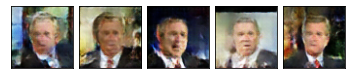

--- EPOCH 334/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.12993649623411543
Generator loss:     5.792497887330897


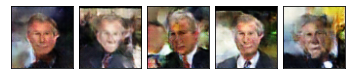

--- EPOCH 335/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.33989496222313714
Generator loss:     6.259624593398151
Saved checkpoint.


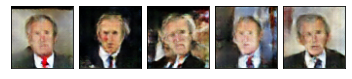

--- EPOCH 336/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.9478875994682312
Generator loss:     5.299765152089736


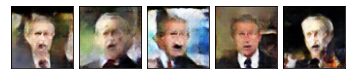

--- EPOCH 337/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.6366877029923832
Generator loss:     4.703749460332534


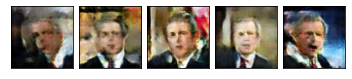

--- EPOCH 338/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.4024408661267337
Generator loss:     4.757443007300882


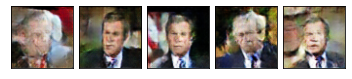

--- EPOCH 339/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.3162788722444983
Generator loss:     4.789642207762775


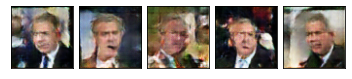

--- EPOCH 340/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.22521323349107714
Generator loss:     4.743792491800645
Saved checkpoint.


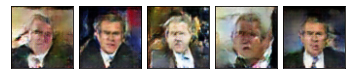

--- EPOCH 341/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.18864284368122325
Generator loss:     5.109509916866527


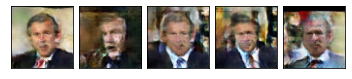

--- EPOCH 342/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.12917790649568334
Generator loss:     5.0928183162913605


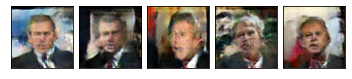

--- EPOCH 343/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.11995238241027384
Generator loss:     4.905543720020967


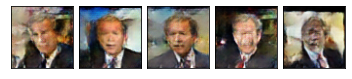

--- EPOCH 344/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.11341966907767688
Generator loss:     5.39383041157442


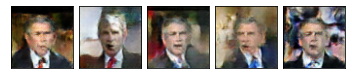

--- EPOCH 345/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.12242918351993841
Generator loss:     5.358867897706873
Saved checkpoint.


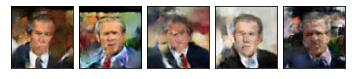

--- EPOCH 346/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.1403946363750626
Generator loss:     5.533655362970689


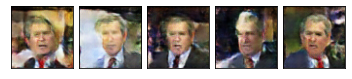

--- EPOCH 347/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.20968593394055085
Generator loss:     5.789068137898164


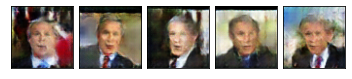

--- EPOCH 348/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.157587437726119
Generator loss:     5.7104043399586395


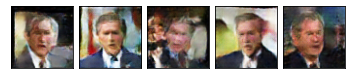

--- EPOCH 349/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.41it/s]
Discriminator loss: 0.13649696199332967
Generator loss:     5.308603455038631


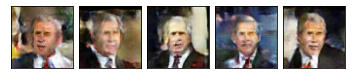

--- EPOCH 350/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.41it/s]
Discriminator loss: 0.09648630023002625
Generator loss:     5.48989340838264
Saved checkpoint.


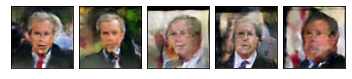

--- EPOCH 351/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.10033938069553937
Generator loss:     5.917546047883875


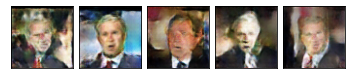

--- EPOCH 352/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.10540039048475378
Generator loss:     5.786894125096938


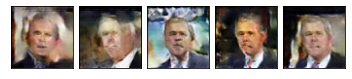

--- EPOCH 353/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.11061633005738258
Generator loss:     6.127747675951789


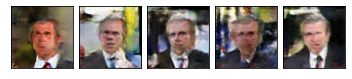

--- EPOCH 354/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.17569205756573117
Generator loss:     5.8609358703388885


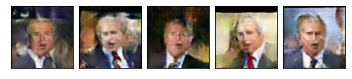

--- EPOCH 355/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.4296685921795228
Generator loss:     6.239030641667983
Saved checkpoint.


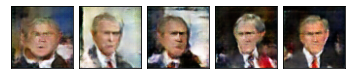

--- EPOCH 356/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.6923614056671367
Generator loss:     5.655656281639548


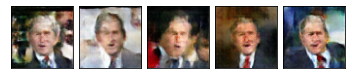

--- EPOCH 357/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.4047384227023405
Generator loss:     4.972259942223044


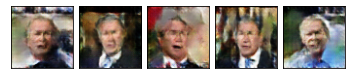

--- EPOCH 358/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.2756573102053474
Generator loss:     5.16208254589754


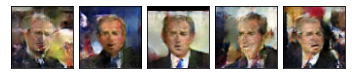

--- EPOCH 359/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.15086950712344227
Generator loss:     4.934814789715936


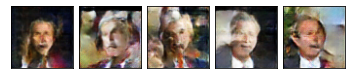

--- EPOCH 360/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.10846620721413809
Generator loss:     5.16553435606115
Saved checkpoint.


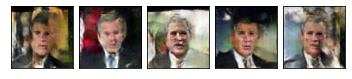

--- EPOCH 361/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.33it/s]
Discriminator loss: 0.1265357206849491
Generator loss:     5.2199094155255485


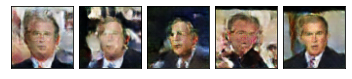

--- EPOCH 362/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.14908876291969242
Generator loss:     5.218084784115062


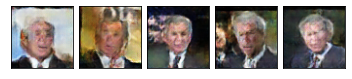

--- EPOCH 363/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.12606699972906532
Generator loss:     5.541472266702091


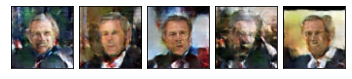

--- EPOCH 364/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.09584321136422017
Generator loss:     5.43720354753382


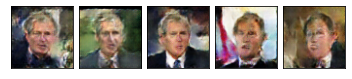

--- EPOCH 365/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.14743376139770537
Generator loss:     5.71955010470222
Saved checkpoint.


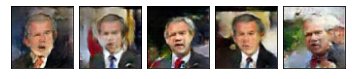

--- EPOCH 366/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.32380835843436856
Generator loss:     5.8663513520184685


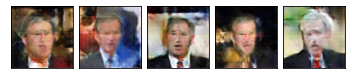

--- EPOCH 367/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.2880519672351725
Generator loss:     5.851499781889074


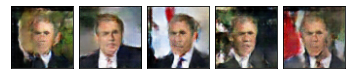

--- EPOCH 368/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.17678957213373744
Generator loss:     5.630877438713522


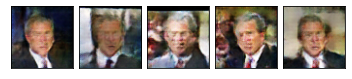

--- EPOCH 369/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.1627154812655028
Generator loss:     5.224767656887279


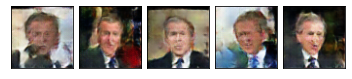

--- EPOCH 370/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.13765542318715768
Generator loss:     5.490201276891372
Saved checkpoint.


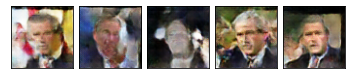

--- EPOCH 371/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.14062823826337562
Generator loss:     5.58961802370408


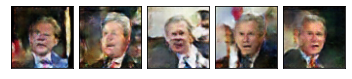

--- EPOCH 372/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.09462763281429515
Generator loss:     5.487793950473561


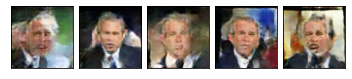

--- EPOCH 373/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.110677445307374
Generator loss:     5.724520879633286


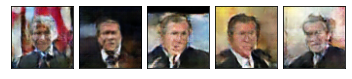

--- EPOCH 374/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.11024236624293468
Generator loss:     5.589740416582893


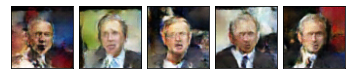

--- EPOCH 375/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.1277927219429437
Generator loss:     6.124289063846364
Saved checkpoint.


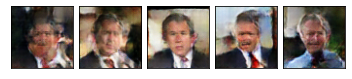

--- EPOCH 376/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.1592567275990458
Generator loss:     6.152816660263959


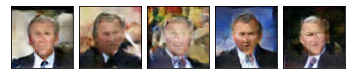

--- EPOCH 377/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.17102012553197496
Generator loss:     6.301939824048211


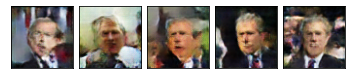

--- EPOCH 378/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.8393403471392744
Generator loss:     5.286322200999541


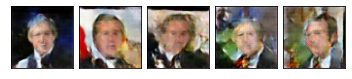

--- EPOCH 379/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.47574459717554207
Generator loss:     5.177105188369751


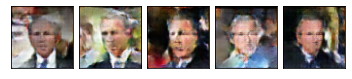

--- EPOCH 380/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.2581559954320683
Generator loss:     4.845474888296688
Saved checkpoint.


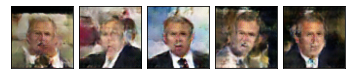

--- EPOCH 381/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.2229200342998785
Generator loss:     5.192446259891286


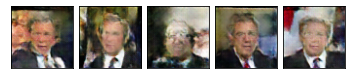

--- EPOCH 382/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.1762864598456551
Generator loss:     5.056757898891673


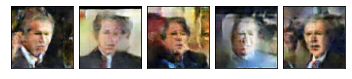

--- EPOCH 383/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.16597050296909668
Generator loss:     5.14156686558443


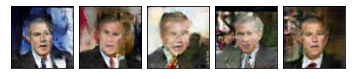

--- EPOCH 384/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.13118531160494862
Generator loss:     5.218013482935288


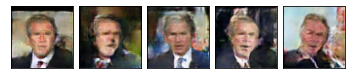

--- EPOCH 385/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.1191523721551194
Generator loss:     5.223148149602554
Saved checkpoint.


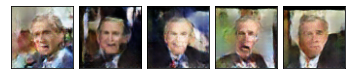

--- EPOCH 386/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.10608867468202815
Generator loss:     5.522224370171042


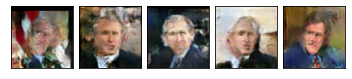

--- EPOCH 387/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.15050377455704353
Generator loss:     5.558953621808221


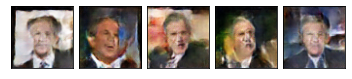

--- EPOCH 388/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.41it/s]
Discriminator loss: 0.07085517487105202
Generator loss:     5.412363094442031


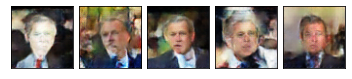

--- EPOCH 389/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.0825121464098201
Generator loss:     5.5326253386104804


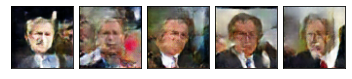

--- EPOCH 390/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.10899853311917361
Generator loss:     5.734136693617877
Saved checkpoint.


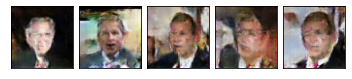

--- EPOCH 391/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.542129834785181
Generator loss:     5.981850441764383


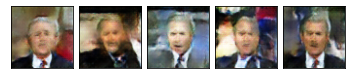

--- EPOCH 392/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.5380618379396551
Generator loss:     5.361799955368042


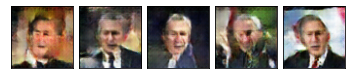

--- EPOCH 393/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.3330685982809347
Generator loss:     5.180903911590576


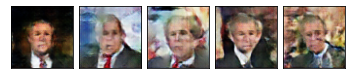

--- EPOCH 394/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.3867173291304532
Generator loss:     5.04625940322876


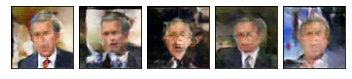

--- EPOCH 395/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.28338781919549494
Generator loss:     4.873048529905431
Saved checkpoint.


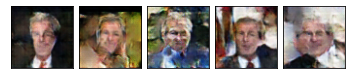

--- EPOCH 396/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.1399436799042365
Generator loss:     4.924194910947015


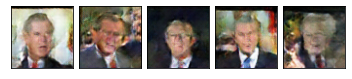

--- EPOCH 397/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.14512268585317276
Generator loss:     5.180992182563333


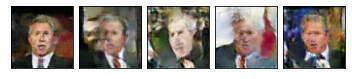

--- EPOCH 398/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.1069288569064263
Generator loss:     5.2703127300038055


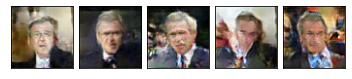

--- EPOCH 399/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.09705662683529012
Generator loss:     5.164120926576502


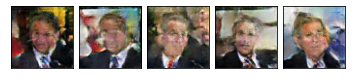

--- EPOCH 400/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.0916970407261568
Generator loss:     5.4457607830272
Saved checkpoint.


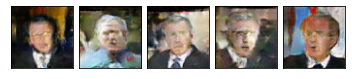

--- EPOCH 401/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.0758441022652037
Generator loss:     5.461886630338781


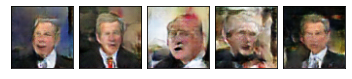

--- EPOCH 402/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.08067316501675283
Generator loss:     5.564068738151999


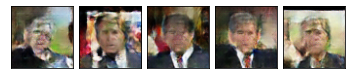

--- EPOCH 403/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.10454358083798605
Generator loss:     5.902286950279684


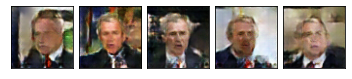

--- EPOCH 404/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.41it/s]
Discriminator loss: 0.12180347411948092
Generator loss:     5.620803019579719


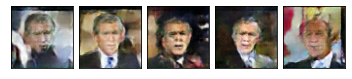

--- EPOCH 405/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.10558728676508455
Generator loss:     5.673925035140094
Saved checkpoint.


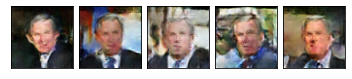

--- EPOCH 406/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.11448802798986435
Generator loss:     5.806744435254266


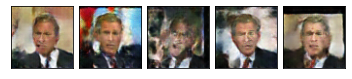

--- EPOCH 407/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.21393625109511263
Generator loss:     6.15783416523653


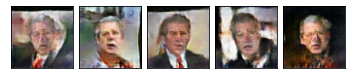

--- EPOCH 408/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.22678978390553417
Generator loss:     5.802950157838709


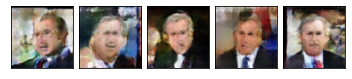

--- EPOCH 409/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.1907463796875056
Generator loss:     5.582703029408174


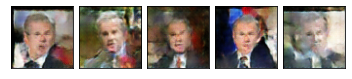

--- EPOCH 410/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.1962319174233605
Generator loss:     5.84275026882396
Saved checkpoint.


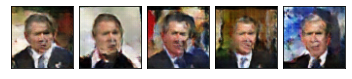

--- EPOCH 411/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.2248366694240009
Generator loss:     5.972036333645091


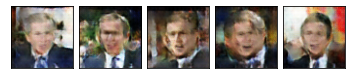

--- EPOCH 412/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.3351934284848325
Generator loss:     5.845827761818381


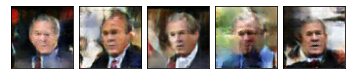

--- EPOCH 413/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.41it/s]
Discriminator loss: 0.6536709929213804
Generator loss:     5.209095379885505


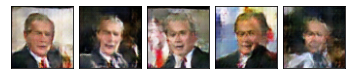

--- EPOCH 414/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.29623037226059856
Generator loss:     4.947081229265998


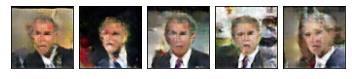

--- EPOCH 415/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.25549012817004146
Generator loss:     5.177873022416058
Saved checkpoint.


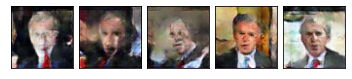

--- EPOCH 416/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.14987950311864123
Generator loss:     5.125603507546818


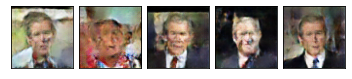

--- EPOCH 417/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.13252038552480586
Generator loss:     5.0813428093405335


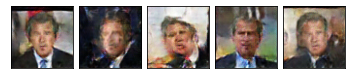

--- EPOCH 418/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.41it/s]
Discriminator loss: 0.07701122388243675
Generator loss:     5.39137254041784


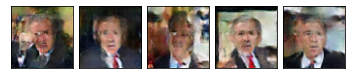

--- EPOCH 419/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.10850908486720394
Generator loss:     5.526532004861271


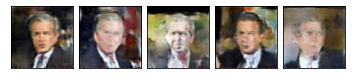

--- EPOCH 420/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.11297629631179221
Generator loss:     5.240852496203254
Saved checkpoint.


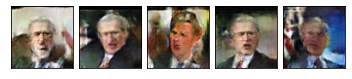

--- EPOCH 421/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.10481685175396063
Generator loss:     5.912035072551054


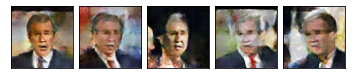

--- EPOCH 422/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.42it/s]
Discriminator loss: 0.08194779489627656
Generator loss:     5.76639809327967


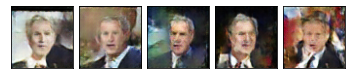

--- EPOCH 423/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.09326627236955307
Generator loss:     5.80789675432093


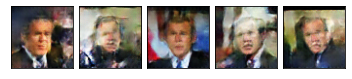

--- EPOCH 424/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.10714468842043597
Generator loss:     5.6130492827471565


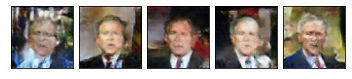

--- EPOCH 425/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.08926474281093653
Generator loss:     5.86293015760534
Saved checkpoint.


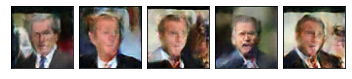

--- EPOCH 426/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.11867778167566832
Generator loss:     5.713261884801528


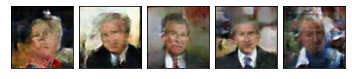

--- EPOCH 427/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.10471697820021826
Generator loss:     5.951946286594167


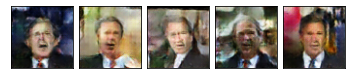

--- EPOCH 428/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.09325635192148826
Generator loss:     6.21813050438376


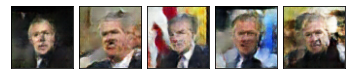

--- EPOCH 429/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.13671017350519404
Generator loss:     6.054942215190215


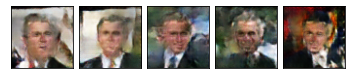

--- EPOCH 430/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.4784402610624538
Generator loss:     6.006721945369945
Saved checkpoint.


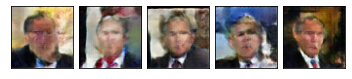

--- EPOCH 431/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.5168298903633567
Generator loss:     5.404322946772856


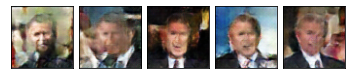

--- EPOCH 432/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.34it/s]
Discriminator loss: 0.49162335430874543
Generator loss:     5.047133123173433


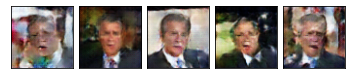

--- EPOCH 433/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.41it/s]
Discriminator loss: 0.3923040041152169
Generator loss:     5.053762800553265


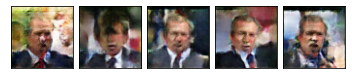

--- EPOCH 434/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.2971693351864815
Generator loss:     5.082016776589787


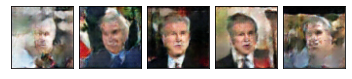

--- EPOCH 435/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.41it/s]
Discriminator loss: 0.19754491593031323
Generator loss:     5.05488920211792
Saved checkpoint.


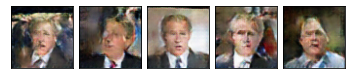

--- EPOCH 436/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.12092285844333031
Generator loss:     5.025887433220358


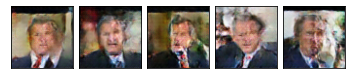

--- EPOCH 437/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.11840088238172672
Generator loss:     4.946417429867913


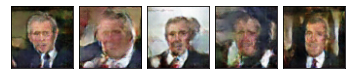

--- EPOCH 438/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.1349845794851289
Generator loss:     5.271601396448472


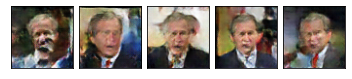

--- EPOCH 439/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.1107534564593259
Generator loss:     5.259279251098633


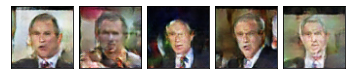

--- EPOCH 440/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.11154248466824784
Generator loss:     5.235807138330796
Saved checkpoint.


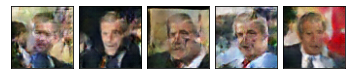

--- EPOCH 441/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.10736214928328991
Generator loss:     5.459779122296502


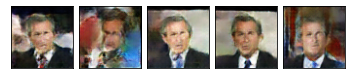

--- EPOCH 442/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.0811059232801199
Generator loss:     5.398154777639053


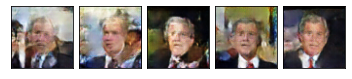

--- EPOCH 443/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.12494171553236597
Generator loss:     5.57578499176923


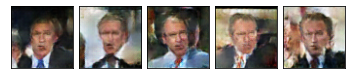

--- EPOCH 444/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.10999610976261251
Generator loss:     5.469957688275506


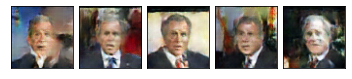

--- EPOCH 445/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.7576097142608726
Generator loss:     5.424237082986271
Saved checkpoint.


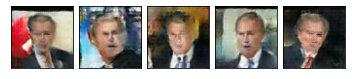

--- EPOCH 446/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.7921036990249858
Generator loss:     4.554209021960988


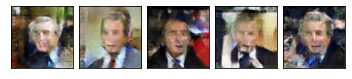

--- EPOCH 447/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.471505261519376
Generator loss:     4.789432483560899


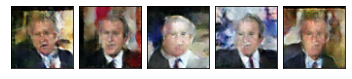

--- EPOCH 448/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.3189074274371652
Generator loss:     4.659017689087811


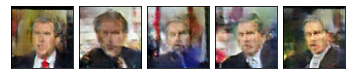

--- EPOCH 449/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.22625860265072653
Generator loss:     4.713044979993035


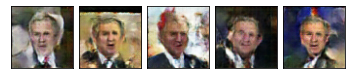

--- EPOCH 450/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.1697321821223287
Generator loss:     4.715335789848776
Saved checkpoint.


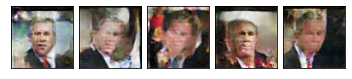

--- EPOCH 451/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.11738234648809713
Generator loss:     5.069923008189482


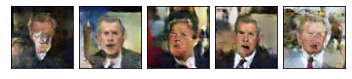

--- EPOCH 452/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.10632846767411512
Generator loss:     4.980402357438031


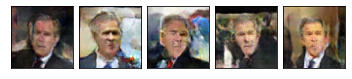

--- EPOCH 453/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.10650463139309603
Generator loss:     5.118016018587


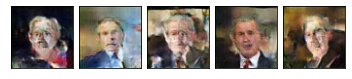

--- EPOCH 454/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.43it/s]
Discriminator loss: 0.07281754647984225
Generator loss:     5.132497591130874


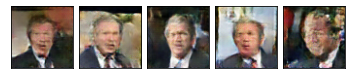

--- EPOCH 455/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.06533226907691535
Generator loss:     5.350962077870088
Saved checkpoint.


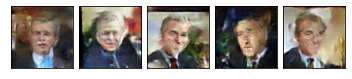

--- EPOCH 456/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.10574723626760875
Generator loss:     5.260554706349092


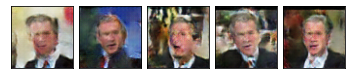

--- EPOCH 457/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.10832209896077127
Generator loss:     5.361445370842429


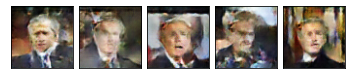

--- EPOCH 458/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.12086573955329026
Generator loss:     5.799888358396642


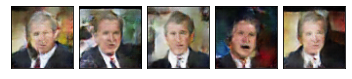

--- EPOCH 459/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.1927622385761317
Generator loss:     5.57817286603591


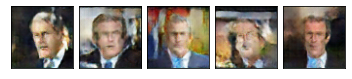

--- EPOCH 460/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.25588125275338397
Generator loss:     5.826927633846507
Saved checkpoint.


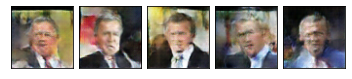

--- EPOCH 461/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.19408199103439555
Generator loss:     5.694661925820744


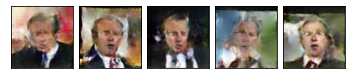

--- EPOCH 462/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.13213825861320777
Generator loss:     5.710037511937759


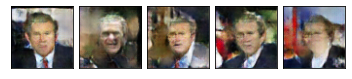

--- EPOCH 463/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.11369499235468752
Generator loss:     5.4033036091748405


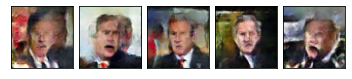

--- EPOCH 464/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.1021078093086972
Generator loss:     5.712272026959588


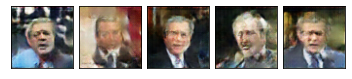

--- EPOCH 465/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.09540007581167362
Generator loss:     5.538446258096134
Saved checkpoint.


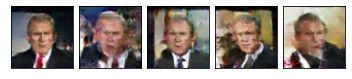

--- EPOCH 466/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.10557356279562502
Generator loss:     5.66172578755547


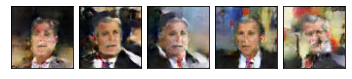

--- EPOCH 467/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.13134384188143647
Generator loss:     5.674332141876221


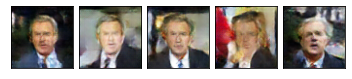

--- EPOCH 468/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.1317250487558982
Generator loss:     5.735731405370376


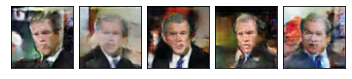

--- EPOCH 469/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.139030380284085
Generator loss:     5.7173067822175865


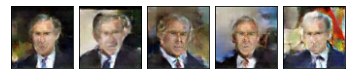

--- EPOCH 470/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.2155533831785707
Generator loss:     5.915001532610725
Saved checkpoint.


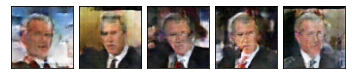

--- EPOCH 471/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.41it/s]
Discriminator loss: 0.19194959849119186
Generator loss:     5.81497189577888


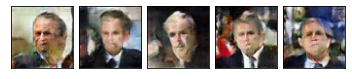

--- EPOCH 472/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.13240154416245573
Generator loss:     5.419694816364961


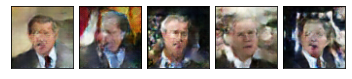

--- EPOCH 473/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.1213777499163852
Generator loss:     5.718741164487951


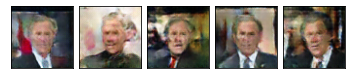

--- EPOCH 474/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.16550291702151299
Generator loss:     5.754458539626178


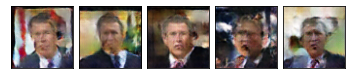

--- EPOCH 475/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.41it/s]
Discriminator loss: 0.1414297268013744
Generator loss:     5.913401687846465
Saved checkpoint.


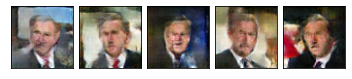

--- EPOCH 476/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.08724904383587487
Generator loss:     5.529005751890295


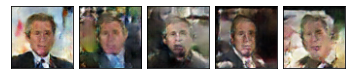

--- EPOCH 477/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.08973319751813132
Generator loss:     5.846398129182703


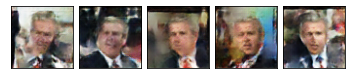

--- EPOCH 478/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.14702888008426218
Generator loss:     6.250657193800983


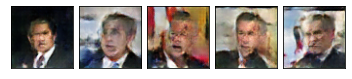

--- EPOCH 479/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.42it/s]
Discriminator loss: 0.8522149832809672
Generator loss:     5.1359171867370605


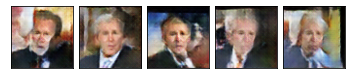

--- EPOCH 480/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.6616088397362653
Generator loss:     4.641487205729765
Saved checkpoint.


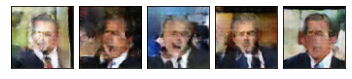

--- EPOCH 481/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.40it/s]
Discriminator loss: 0.4153825377716738
Generator loss:     4.494752687566421


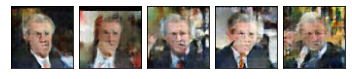

--- EPOCH 482/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.40it/s]
Discriminator loss: 0.32566435722743764
Generator loss:     4.733198951272404


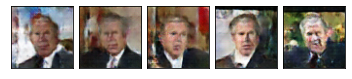

--- EPOCH 483/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.23655107792686014
Generator loss:     4.797440136180205


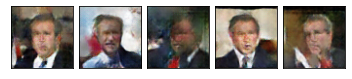

--- EPOCH 484/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.1718419680426664
Generator loss:     4.885200458414414


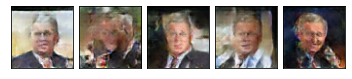

--- EPOCH 485/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.35it/s]
Discriminator loss: 0.126673593021491
Generator loss:     5.174608763526468
Saved checkpoint.


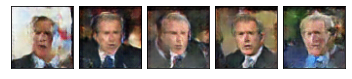

--- EPOCH 486/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.13486124629921772
Generator loss:     5.047480204526116


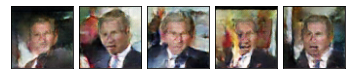

--- EPOCH 487/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.13717505774077246
Generator loss:     5.249871857026044


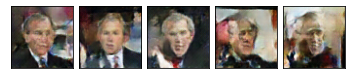

--- EPOCH 488/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.08870279394528445
Generator loss:     5.283458232879639


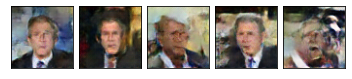

--- EPOCH 489/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.07683954037287656
Generator loss:     5.4429531658397


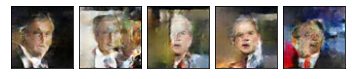

--- EPOCH 490/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.07856258706134908
Generator loss:     5.502509930554559
Saved checkpoint.


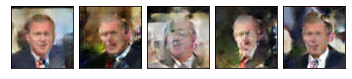

--- EPOCH 491/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.06200325549306238
Generator loss:     5.479841260349049


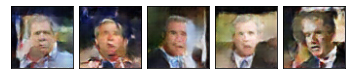

--- EPOCH 492/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.13576901791726842
Generator loss:     5.43984665590174


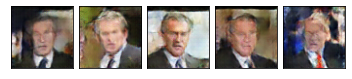

--- EPOCH 493/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.36it/s]
Discriminator loss: 0.11571782871204264
Generator loss:     5.623178790597355


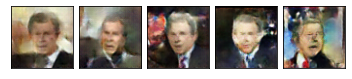

--- EPOCH 494/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.05414496986743282
Generator loss:     5.497268564560834


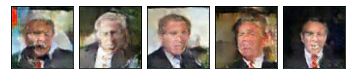

--- EPOCH 495/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.41it/s]
Discriminator loss: 0.1351335326976636
Generator loss:     5.910917169907513
Saved checkpoint.


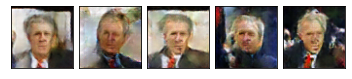

--- EPOCH 496/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.41it/s]
Discriminator loss: 0.5930716406334849
Generator loss:     5.3921864593730255


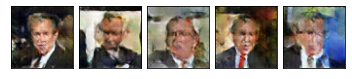

--- EPOCH 497/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.39it/s]
Discriminator loss: 0.4727543539860669
Generator loss:     4.981481145409977


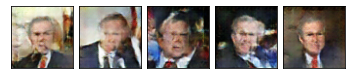

--- EPOCH 498/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.38it/s]
Discriminator loss: 0.3373933899052003
Generator loss:     5.06882521685432


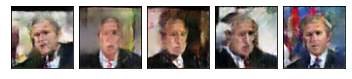

--- EPOCH 499/500 ---
100%|██████████| 17/17 [00:05<00:00,  3.37it/s]
Discriminator loss: 0.24135206508285859
Generator loss:     5.019234166425817


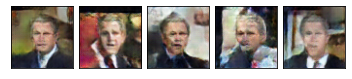

--- EPOCH 500/500 ---
100%|██████████| 17/17 [00:04<00:00,  3.41it/s]
Discriminator loss: 0.2490595607634853
Generator loss:     4.8099243921392105
Saved checkpoint.


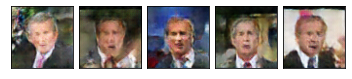

In [11]:
import IPython.display
import tqdm
from dcgan import train_batch, save_checkpoint

num_epochs = 500

# if os.path.isfile(f'{checkpoint_file_final}.pt'):
#     print(f'*** Loading final checkpoint file {checkpoint_file_final} instead of training')
#     num_epochs = 0
#     gen = torch.load(f'{checkpoint_file_final}.pt', map_location=device)
#     checkpoint_file = checkpoint_file_final

try:
    dsc_avg_losses, gen_avg_losses = [], []
    for epoch_idx in range(num_epochs):
        # We'll accumulate batch losses and show an average once per epoch.
        dsc_losses, gen_losses = [], []
        print(f'--- EPOCH {epoch_idx+1}/{num_epochs} ---')

        with tqdm.tqdm(total=len(dl_train.batch_sampler), file=sys.stdout) as pbar:
            for batch_idx, (x_data, _) in enumerate(dl_train):
                x_data = x_data.to(device)
                dsc_loss, gen_loss = train_batch(
                    dsc, gen,
                    dsc_loss_fn, gen_loss_fn,
                    dsc_optimizer, gen_optimizer,
                    x_data)
                dsc_losses.append(dsc_loss)
                gen_losses.append(gen_loss)
                pbar.update()

        dsc_avg_losses.append(np.mean(dsc_losses))
        gen_avg_losses.append(np.mean(gen_losses))
        print(f'Discriminator loss: {dsc_avg_losses[-1]}')
        print(f'Generator loss:     {gen_avg_losses[-1]}')
        
        if save_checkpoint(gen, dsc_avg_losses, gen_avg_losses, checkpoint_file):
            print(f'Saved checkpoint.')
            
        samples = gen.sample(5, with_grad=False)
        fig, _ = plot.tensors_as_images(samples.cpu(), figsize=(6,2))
        IPython.display.display(fig)
        plt.close(fig)
except KeyboardInterrupt as e:
    print('\n *** Training interrupted by user')

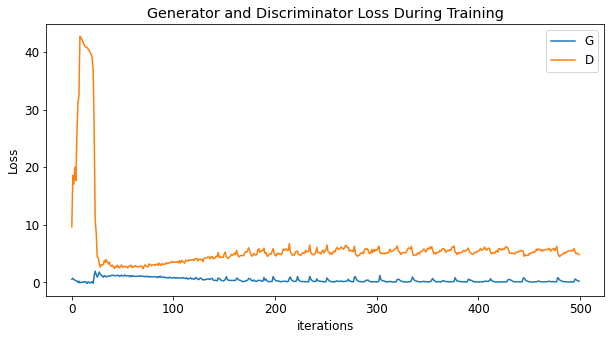

In [12]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(dsc_avg_losses,label="G")
plt.plot(gen_avg_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

*** Images Generated from best model:


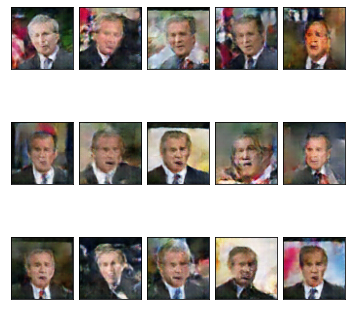

In [13]:
# Plot images from best or last model
if os.path.isfile(f'{checkpoint_file}.pt'):
    gen = torch.load(f'{checkpoint_file}.pt', map_location=device)
print('*** Images Generated from best model:')
samples = gen.sample(n=15, with_grad=False).cpu()
fig, _ = plot.tensors_as_images(samples, nrows=3, figsize=(6,6))